# Light curve features (II)

**Advanced Astroinformatics Student Project**

*N. Hernitschek, 2022*



---
## Contents
* [Recap, Questions](#first-bullet)
* [Continue with feature extraction](#second-bullet)
* [Plotting features](#third-bullet)
* [Summary](#fifth-bullet)


## 1. Recap, Questions <a class="anchor" id="first-bullet"></a>

Time for questions!

Your **tasks until this week** were:

Try running the Fourier transformation, Lomb-Scargle Periodogram, and the feature extraction from the `feets` package on all stars from the TESS sample and report any issues you encounter.

hints:
* it will be faster if you run the code not in the Jupyter notebook, but write a Python code file and execute it from the command line
* think about which data should be written to your output table.

## 1. Continue with feature extraction <a class="anchor" id="second-bullet"></a>


### compare calculated features


The `feets` package provides the period features `PeriodLS` and `Period_fit`.
By using the documentation (website and paper), and your results, compare them.

Were period features calculated which seem to be unrealistic? How do you decide whether they are unrealistic?
Hint: type of star, length of light curve


### replace features calculated by `feets`


For the `feets` package, there is a bug reported regarding three features: `AndersonDarling`,`StetsonK`,`StetsonK_AC`.

To replace those features, look them up online. They are available in other common packages, and/or you can write the equations on your own.

Then rerun the feature calculation code with the following parameters:


In [1]:

# exclude features "AndersonDarling","StetsonK","StetsonK_AC" as they are unreliable
fs = feets.FeatureSpace(data = ['time', 'magnitude', 'error'], exclude=["AndersonDarling","StetsonK","StetsonK_AC"])


NameError: name 'feets' is not defined

Replacement for Anderson-Darling test
https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.anderson.html


and calculate the `AndersonDarling`,`StetsonK`,`StetsonK_AC` using other methods. Again, write a feature output table.
                            

## 2. Plotting features <a class="anchor" id="third-bullet"></a>


To compare which part of the **feature space** is occupied by different types of stars, we can use a **corner plot**. You have already installed the `corner` library in week 2.

Before running `corner` on your feature table (this will take a while), let's first plot some mock data to set up the plot.

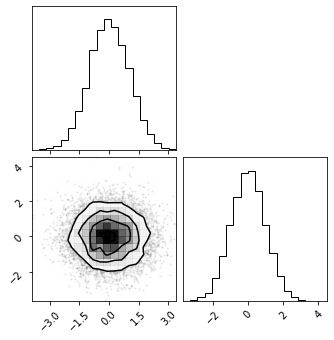

In [2]:
# a very basic corner plot

import corner
import numpy as np

# create mock data
ndim, nsamples = 2, 10000
np.random.seed(42)
samples = np.random.randn(ndim * nsamples).reshape([nsamples, ndim])
figure = corner.corner(samples)


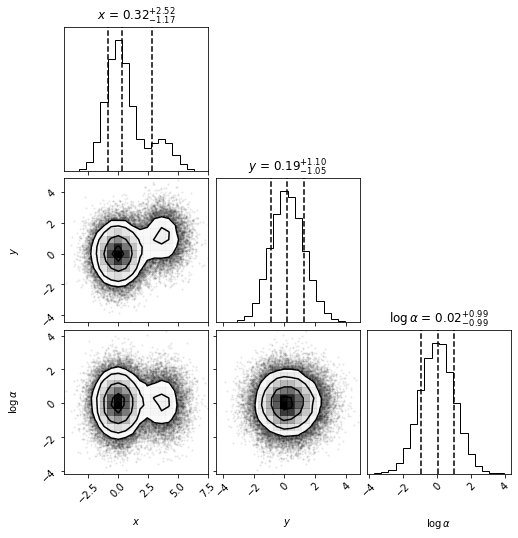

In [2]:

#that's how a corner plot for e.g. your report, or a publication should look like

# create mock data
ndim, nsamples = 3, 50000

# Generate some fake data.
np.random.seed(42)
data1 = np.random.randn(ndim * 4 * nsamples // 5).reshape([4 * nsamples // 5, ndim])
data2 = (4*np.random.rand(ndim)[None, :] + np.random.randn(ndim * nsamples // 5).reshape([nsamples // 5, ndim]))
data = np.vstack([data1, data2])

# the operator // is the Floor division (dividing and rounding down to the nearest integer.)

# Plot it.
figure = corner.corner(data, labels=[r"$x$", r"$y$", r"$\log \alpha$", r"$\Gamma \, [\mathrm{parsec}]$"],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12})

In [6]:
data2.shape

(10000, 3)

We now want to create two data sets and plot them in the same corner plot.

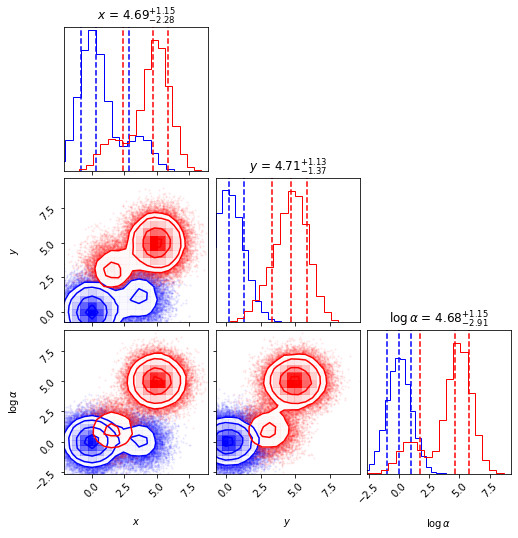

In [33]:
 

# create mock data
ndim, nsamples = 3, 50000

# Generate some fake data.
np.random.seed(42)
data1 = np.random.randn(ndim * 4 * nsamples // 5).reshape([4 * nsamples // 5, ndim]) 
data2 = (4*np.random.rand(ndim)[None, :] + np.random.randn(ndim * nsamples // 5).reshape([nsamples // 5, ndim]))


data3 = np.random.randn(ndim * 4 * nsamples // 5).reshape([4 * nsamples // 5, ndim])+ 5.0
data4 = (4*np.random.rand(ndim)[None, :] + np.random.randn(ndim * nsamples // 5).reshape([nsamples // 5, ndim]))


data_1 = np.vstack([data1, data2])
data_2 = np.vstack([data3, data4])


# Plot it.
figure = corner.corner(data_1, labels=[r"$x$", r"$y$", r"$\log \alpha$", r"$\Gamma \, [\mathrm{parsec}]$"],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, color='blue')

figure = corner.corner(data_2, labels=[r"$x$", r"$y$", r"$\log \alpha$", r"$\Gamma \, [\mathrm{parsec}]$"],
                       quantiles=[0.16, 0.5, 0.84],
                       show_titles=True, title_kwargs={"fontsize": 12}, color='red', fig=figure)


In [26]:
data4.shape

(10000, 3)

**Your tasks until next week:**

Create a feature table showing the calculated features for all variable stars in the TESS sample (using the _TESS_lightcurves_outliercleaned light curves).

Use this feature table to create a triangle plot showing the features first for all variable stars from one star type (e.g.: ACV). If this works, for each type create a triangle plot.
Then, calculate the feature table also for the other versions of the light curves (_TESS_lightcurves_median_after_detrended, _TESS_lightcurves_raw). Overplot these features to each of your triangle plots. (I.e.: After this step you should have individual triangle plots for the types ACV, CEP, DCEP..., showing the calculated features for te raw, median/detrended, and outlier cleaned light curves.)

What do these triangle plots tell you?


In [71]:
import numpy as np
import pandas as pd
import corner
from matplotlib import pyplot as plt
%config InlineBackend.figure_format='retina'
import seaborn as sns

In [72]:
# Read data
df = pd.read_csv("outputs/nb3/features_.csv")

In [ ]:
vtypes = df.type.unique()

In [74]:
df.columns

Index(['Unnamed: 0', 'Amplitude', 'Autocor_length', 'Beyond1Std', 'CAR_mean',
       'CAR_sigma', 'CAR_tau', 'Con', 'Eta_e', 'FluxPercentileRatioMid20',
       'FluxPercentileRatioMid35', 'FluxPercentileRatioMid50',
       'FluxPercentileRatioMid65', 'FluxPercentileRatioMid80',
       'Freq1_harmonics_amplitude_0', 'Freq1_harmonics_amplitude_1',
       'Freq1_harmonics_amplitude_2', 'Freq1_harmonics_amplitude_3',
       'Freq1_harmonics_rel_phase_0', 'Freq1_harmonics_rel_phase_1',
       'Freq1_harmonics_rel_phase_2', 'Freq1_harmonics_rel_phase_3',
       'Freq2_harmonics_amplitude_0', 'Freq2_harmonics_amplitude_1',
       'Freq2_harmonics_amplitude_2', 'Freq2_harmonics_amplitude_3',
       'Freq2_harmonics_rel_phase_0', 'Freq2_harmonics_rel_phase_1',
       'Freq2_harmonics_rel_phase_2', 'Freq2_harmonics_rel_phase_3',
       'Freq3_harmonics_amplitude_0', 'Freq3_harmonics_amplitude_1',
       'Freq3_harmonics_amplitude_2', 'Freq3_harmonics_amplitude_3',
       'Freq3_harmonics_rel_pha

Amplitude


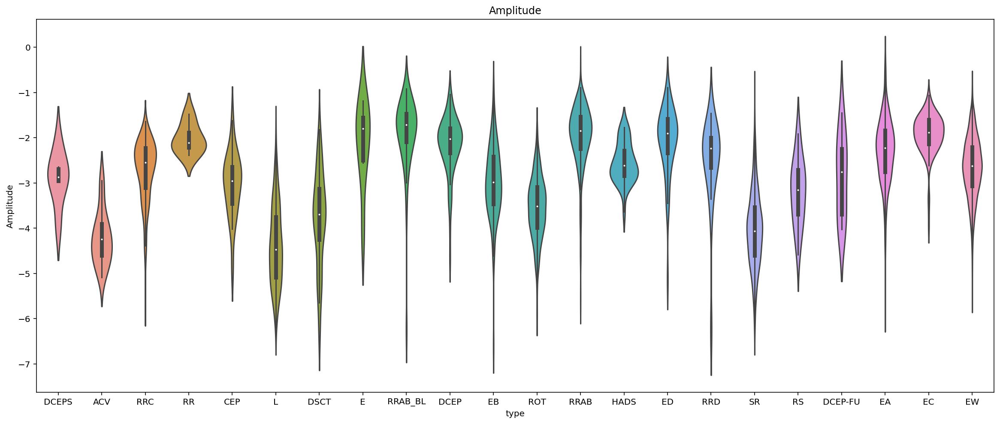

Autocor_length


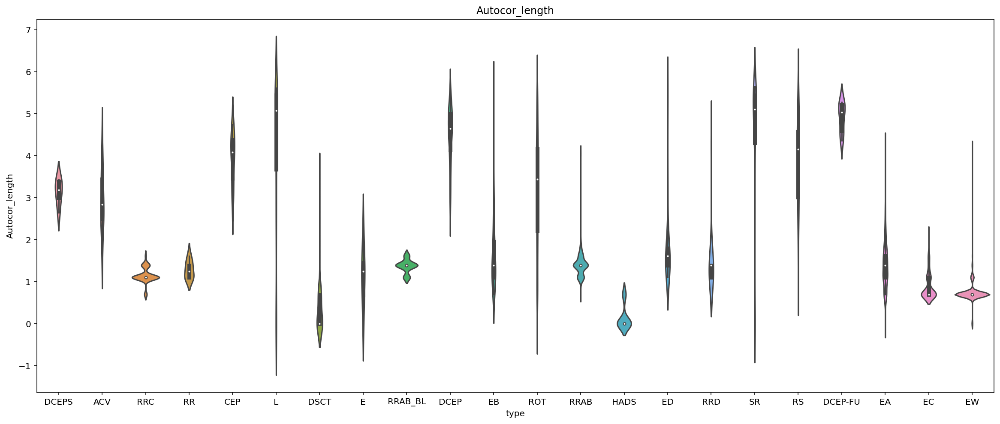

Beyond1Std


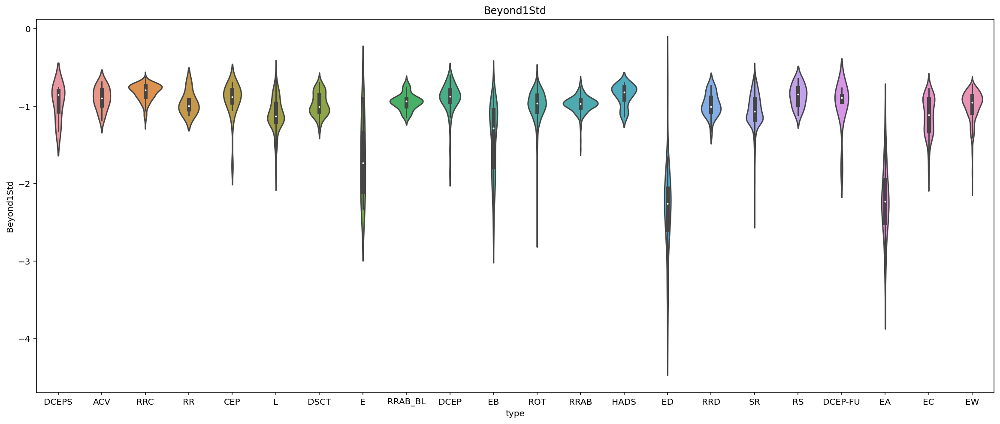

CAR_mean


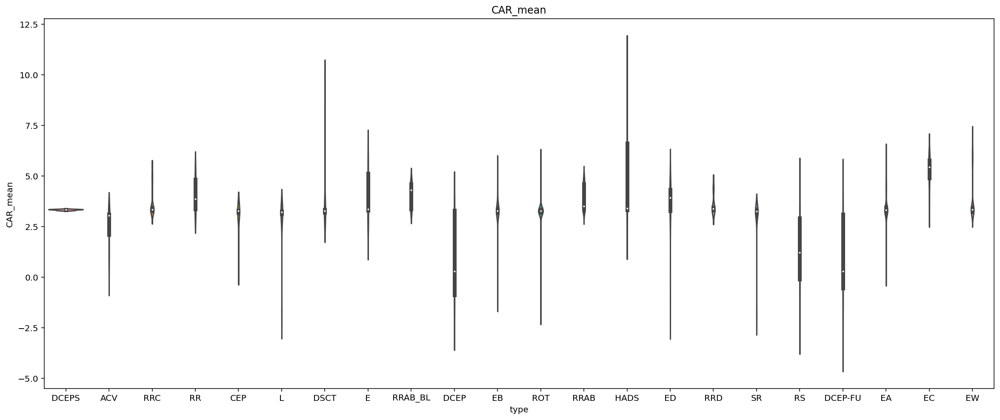

CAR_tau


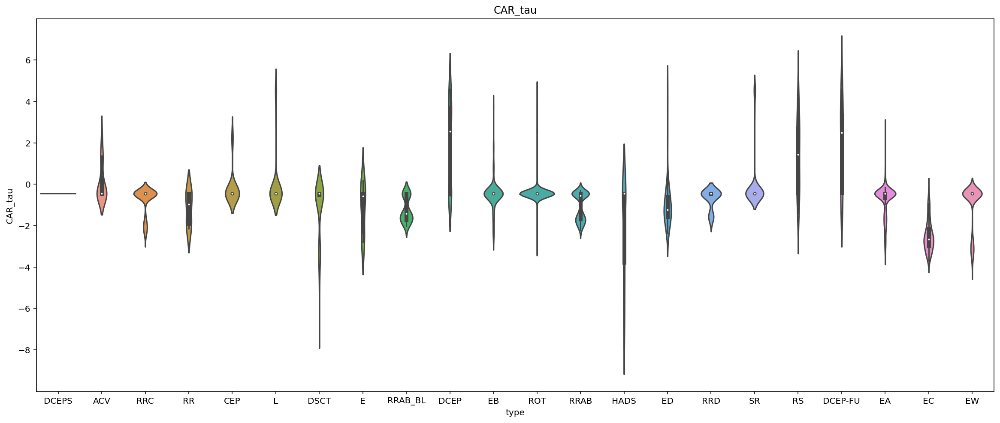

Eta_e


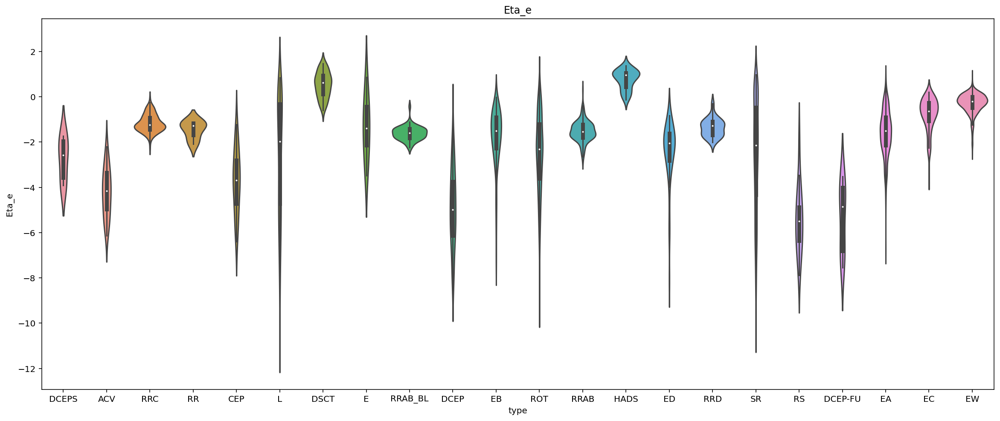

FluxPercentileRatioMid20


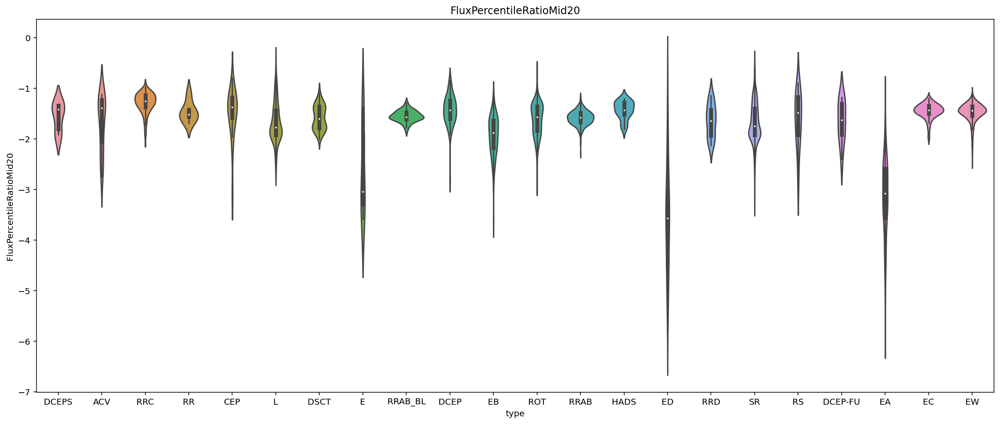

FluxPercentileRatioMid35


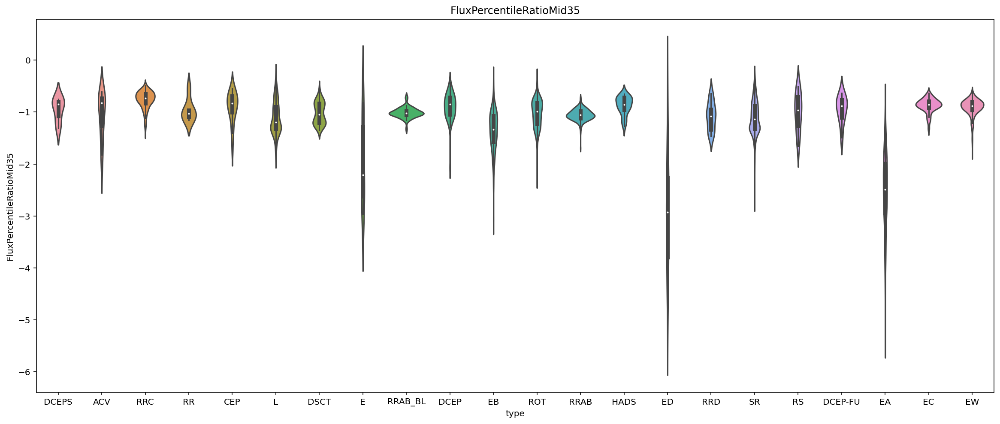

FluxPercentileRatioMid50


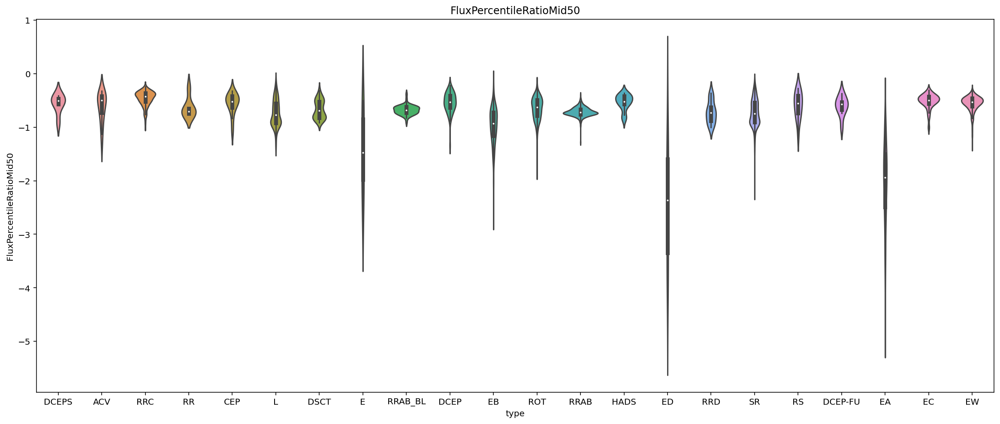

FluxPercentileRatioMid65


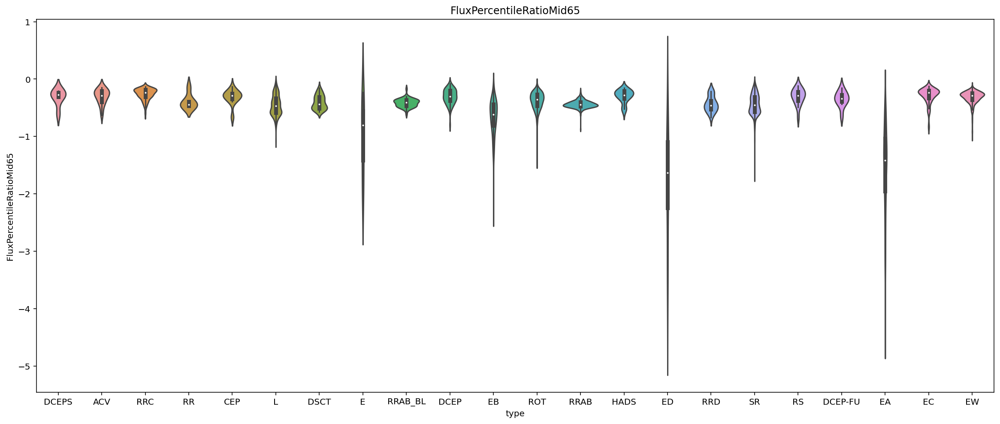

FluxPercentileRatioMid80


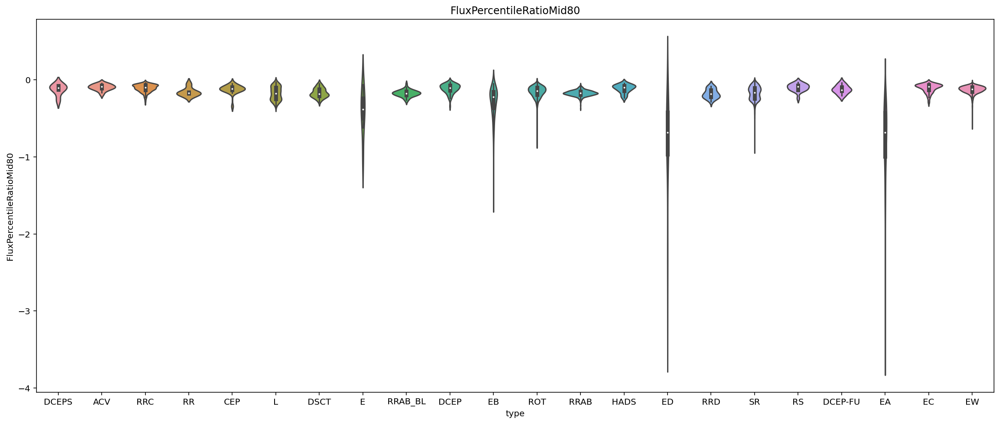

Freq1_harmonics_amplitude_0


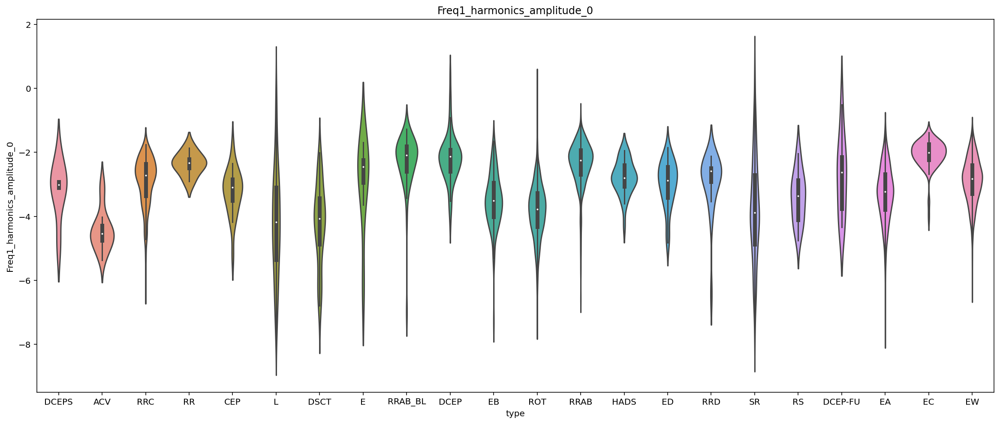

Freq1_harmonics_amplitude_1


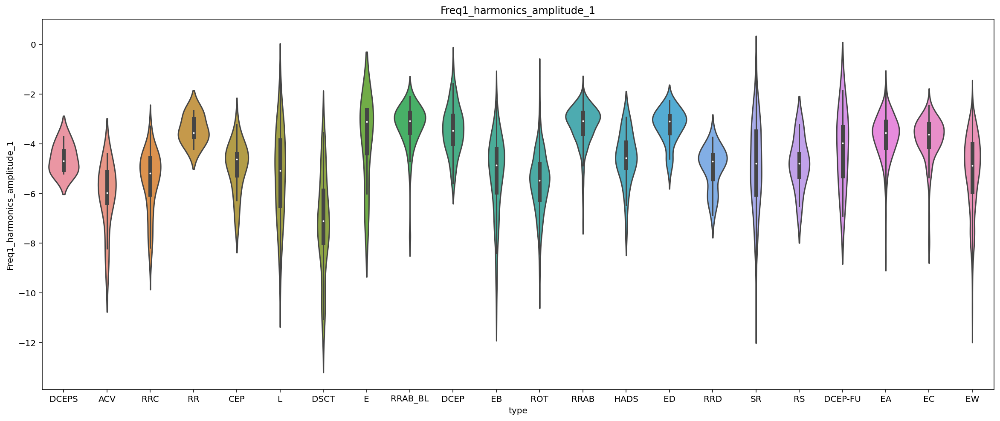

Freq1_harmonics_amplitude_2


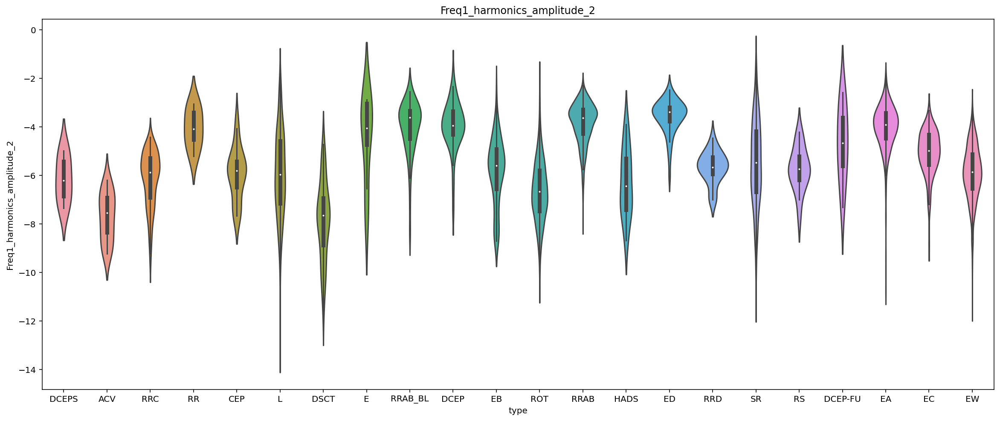

Freq1_harmonics_amplitude_3


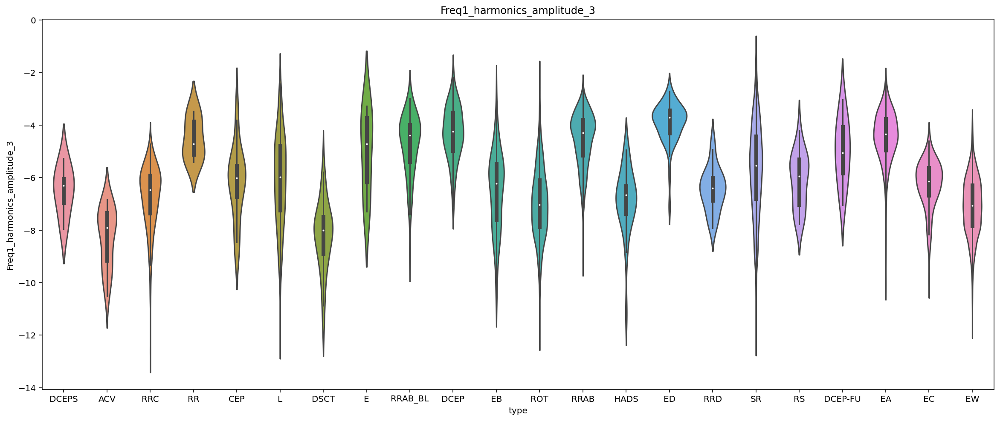

Freq1_harmonics_rel_phase_0


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


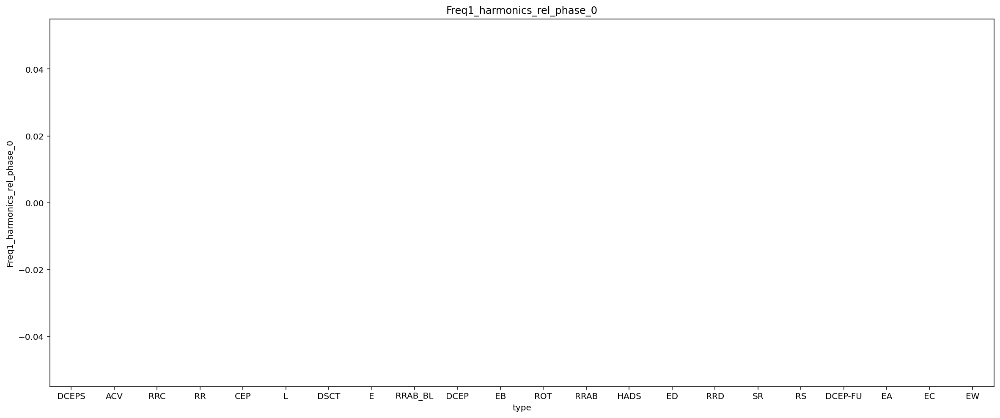

Freq1_harmonics_rel_phase_1


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


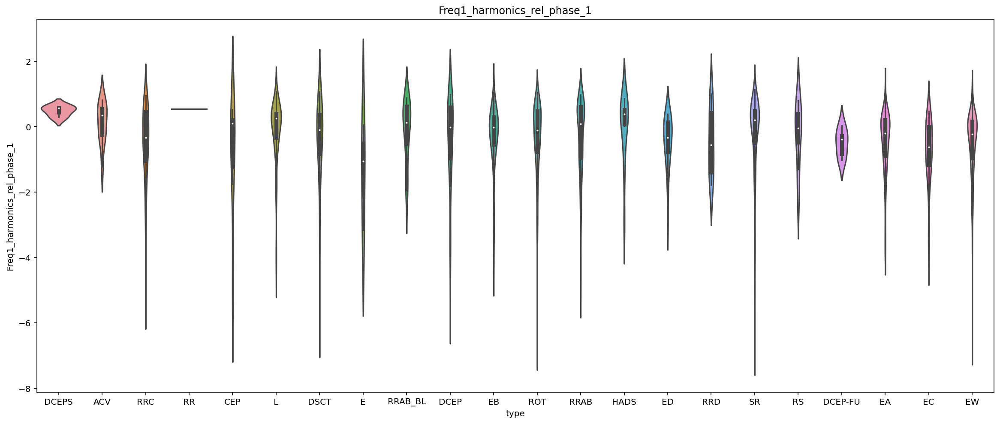

Freq1_harmonics_rel_phase_2


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


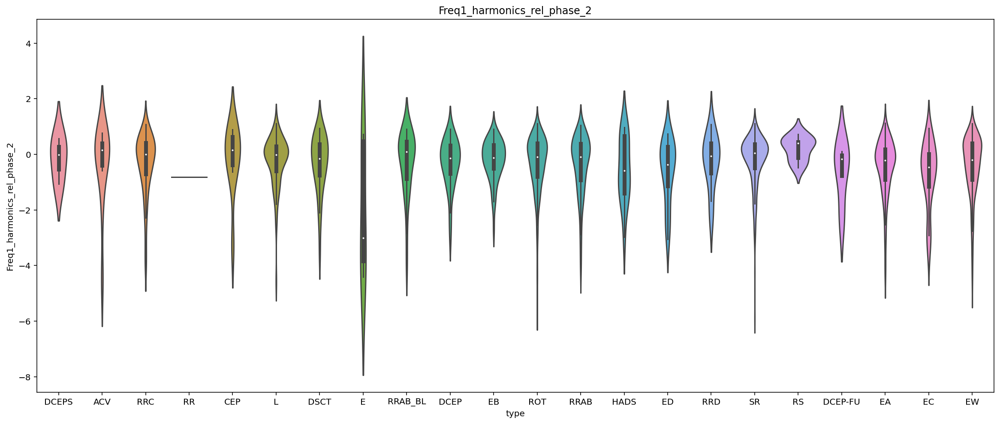

Freq1_harmonics_rel_phase_3


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


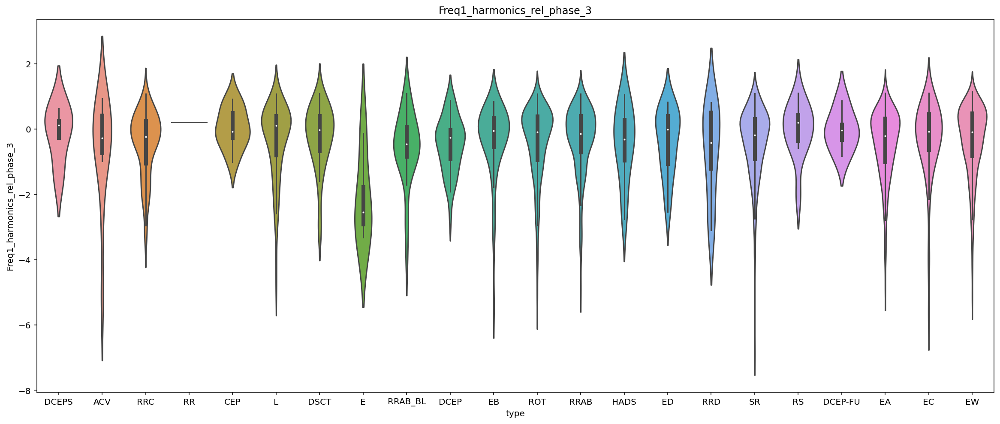

Freq2_harmonics_amplitude_0


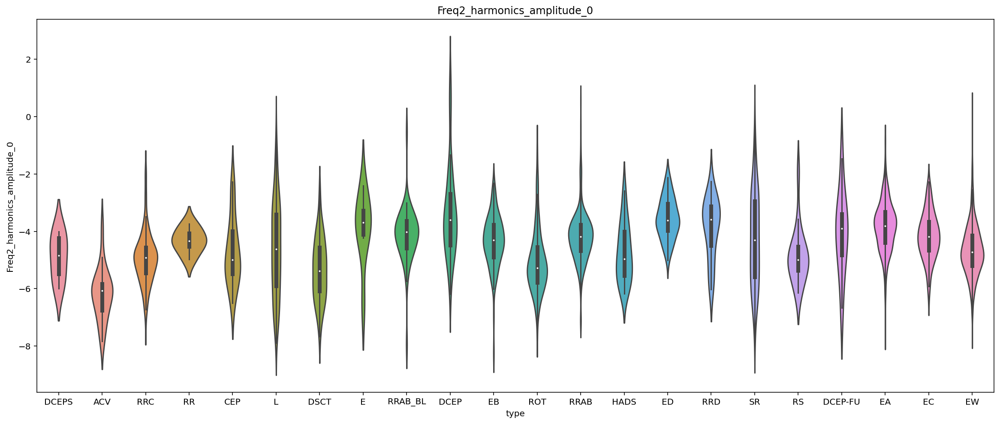

Freq2_harmonics_amplitude_1


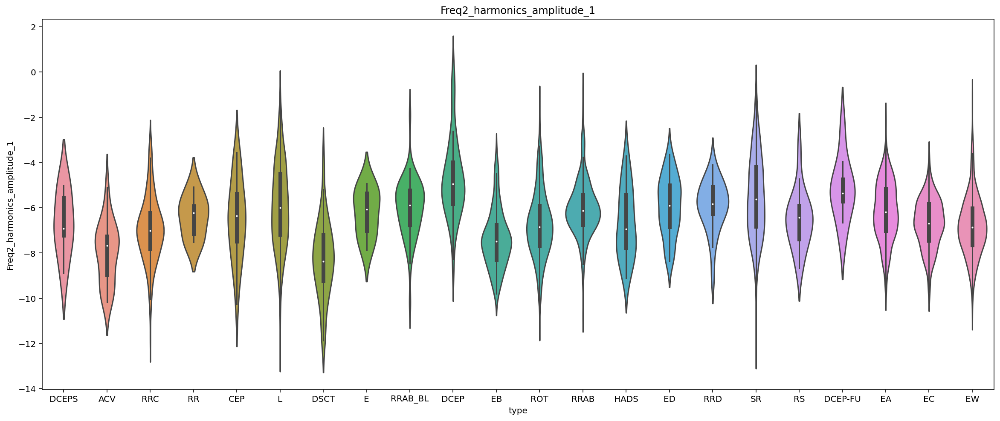

Freq2_harmonics_amplitude_2


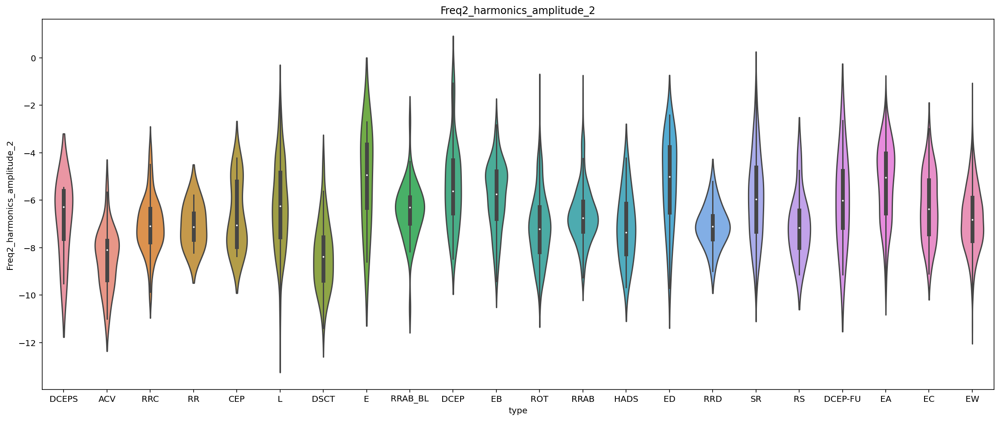

Freq2_harmonics_amplitude_3


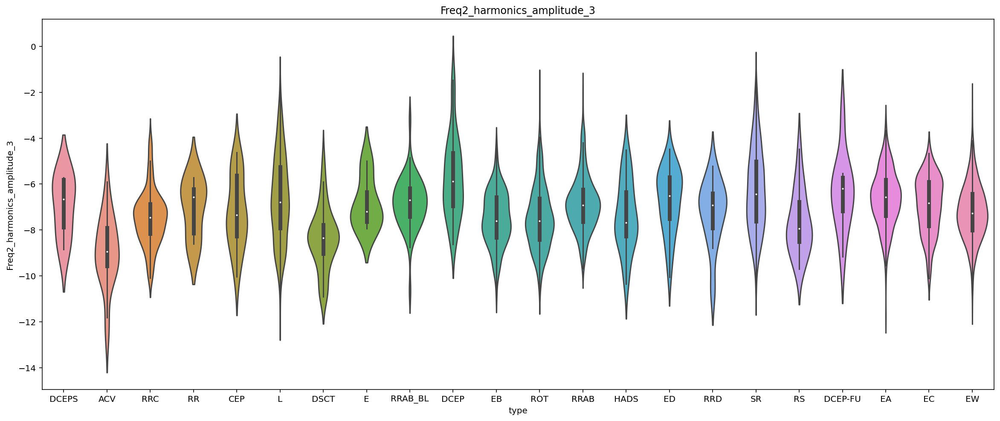

Freq2_harmonics_rel_phase_0


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


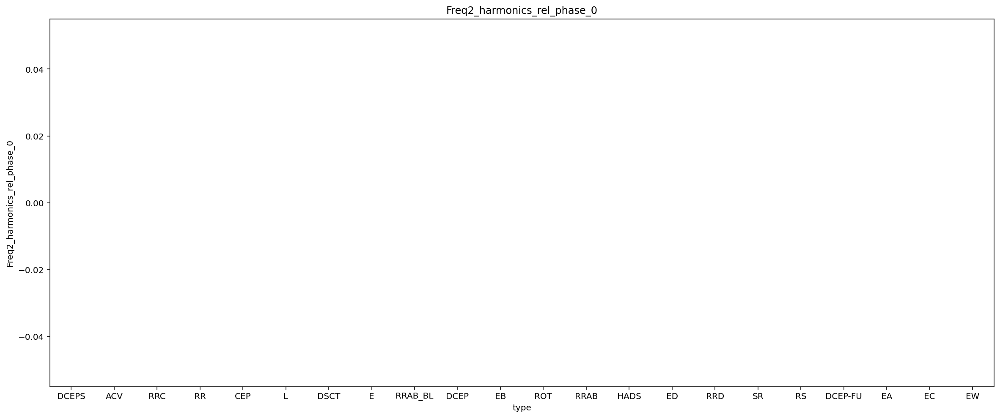

Freq2_harmonics_rel_phase_1


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


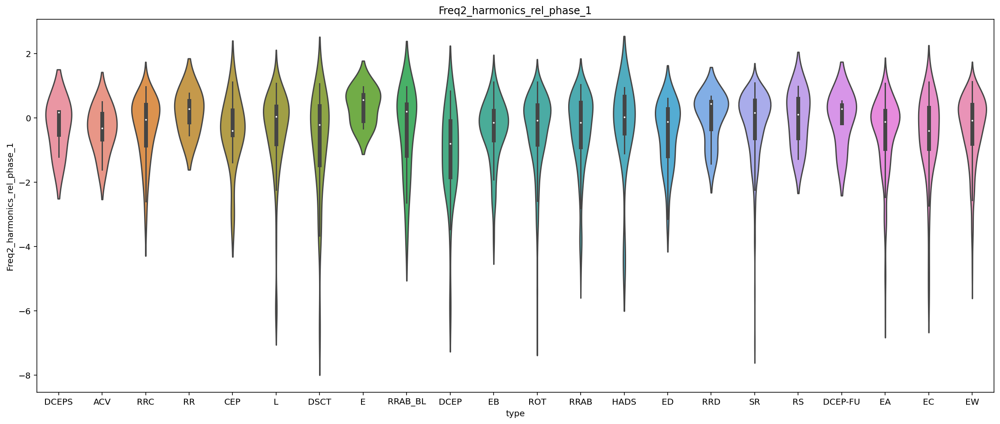

Freq2_harmonics_rel_phase_2


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


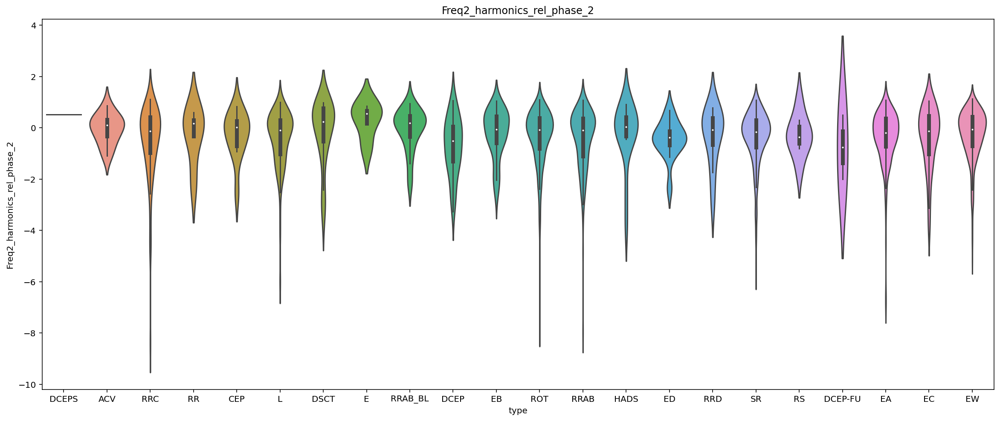

Freq2_harmonics_rel_phase_3


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


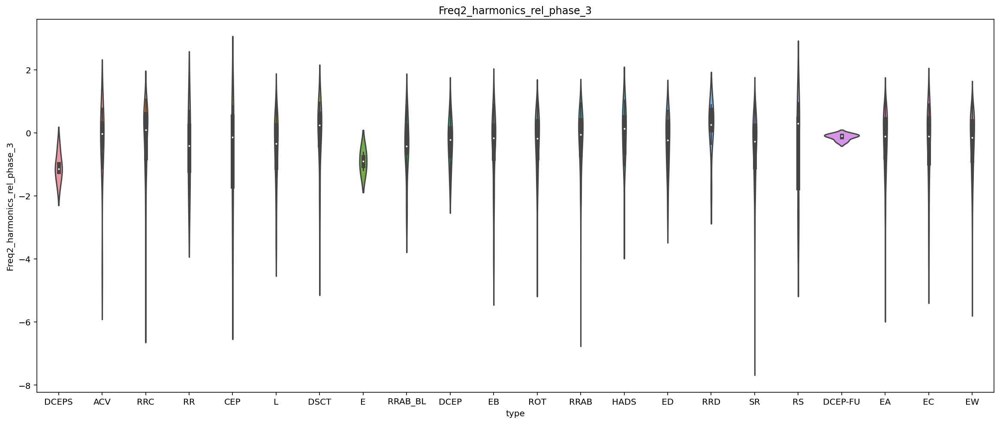

Freq3_harmonics_amplitude_0


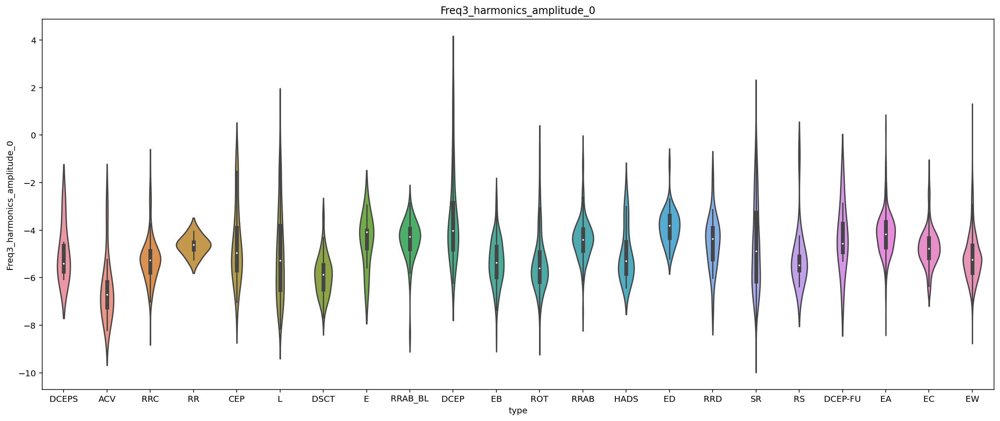

Freq3_harmonics_amplitude_1


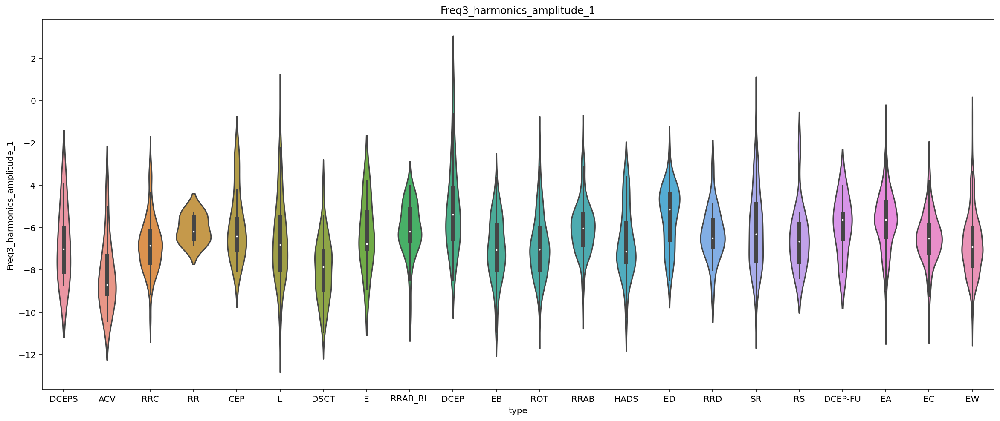

Freq3_harmonics_amplitude_2


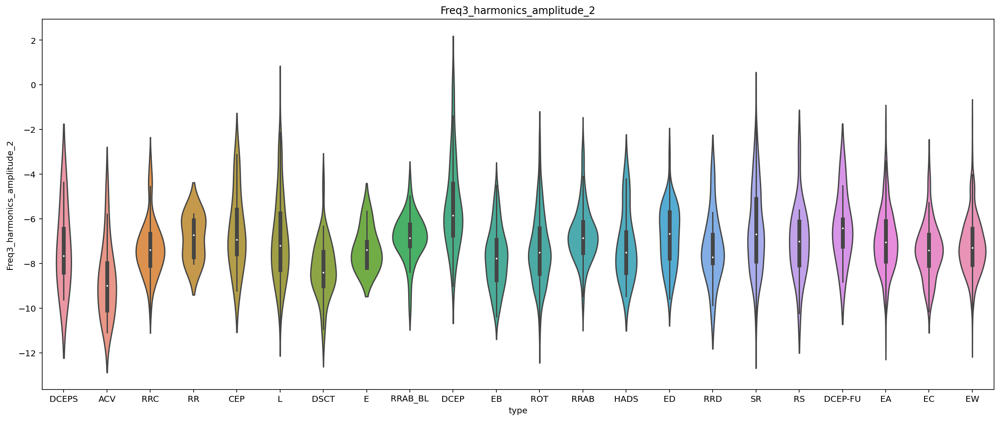

Freq3_harmonics_amplitude_3


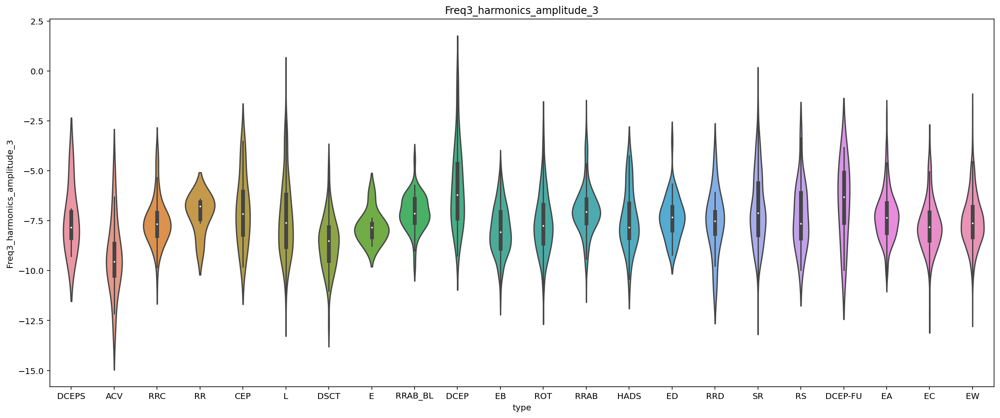

Freq3_harmonics_rel_phase_0


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


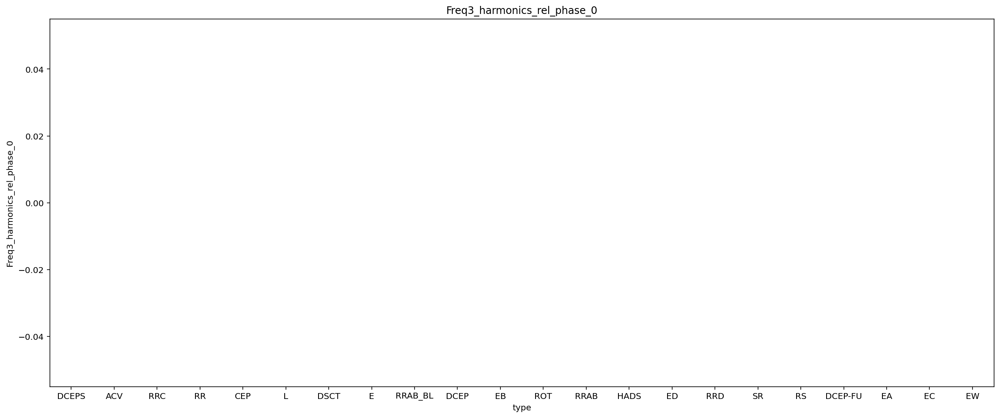

Freq3_harmonics_rel_phase_1


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


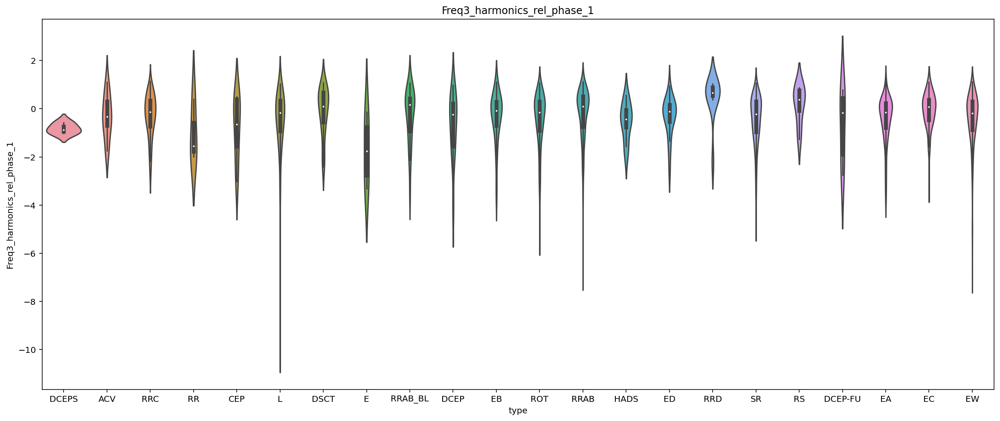

Freq3_harmonics_rel_phase_2


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


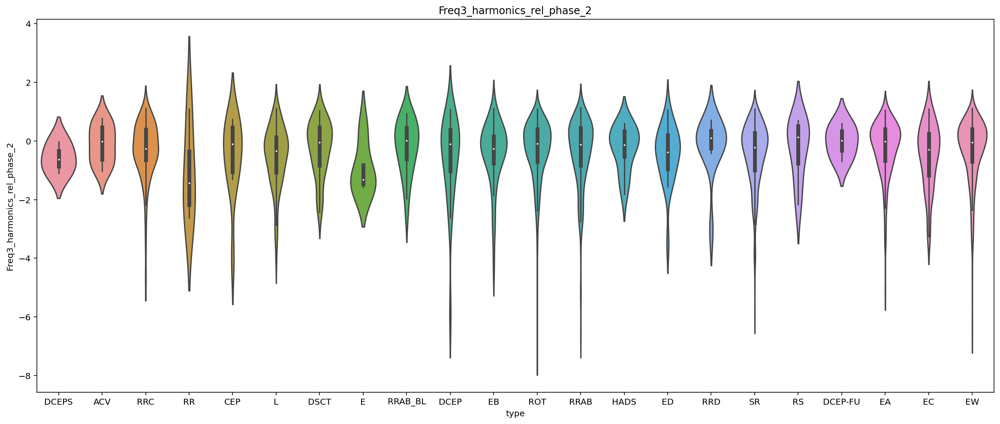

Freq3_harmonics_rel_phase_3


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


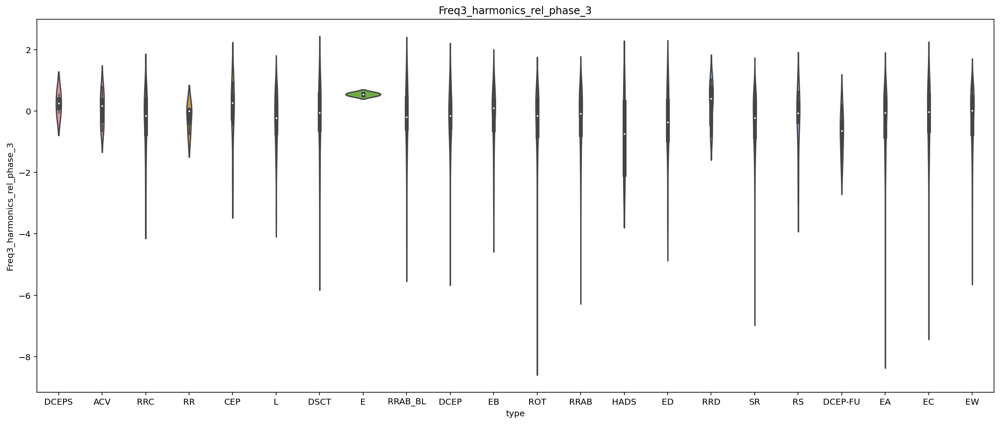

Gskew


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


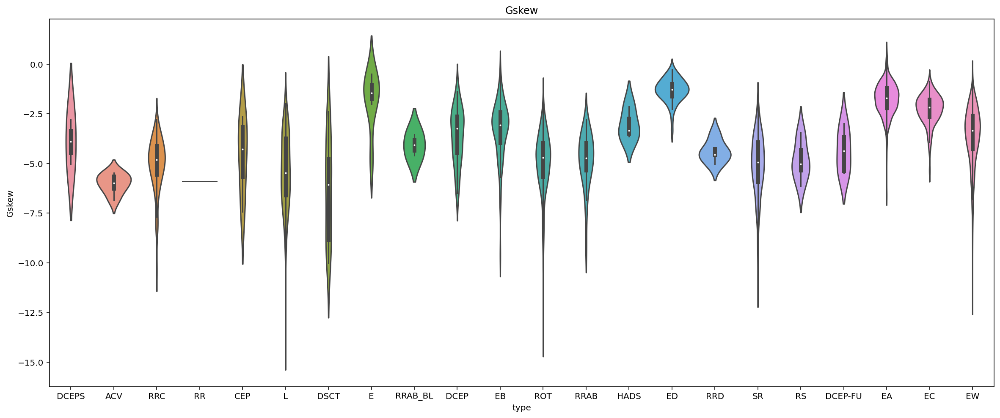

LinearTrend


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


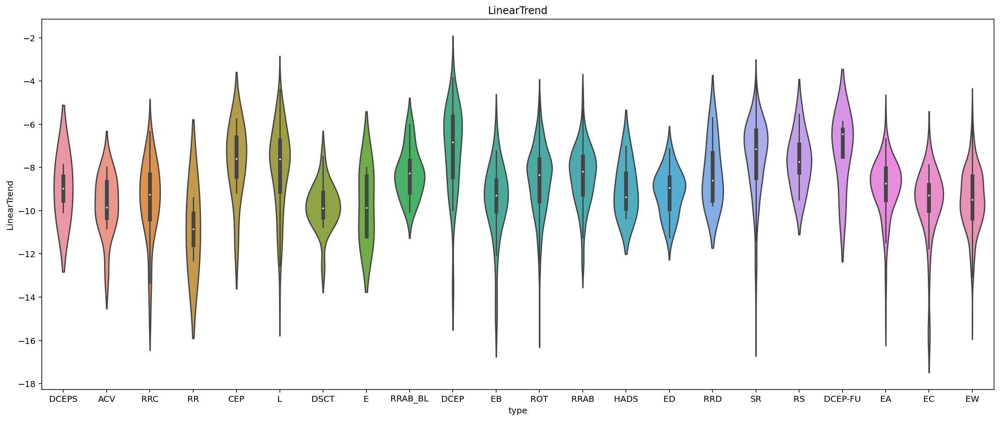

MaxSlope


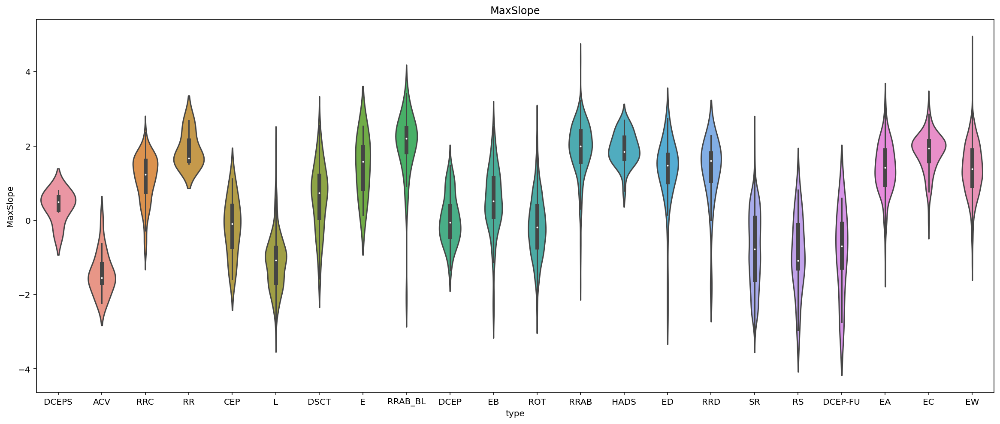

Mean


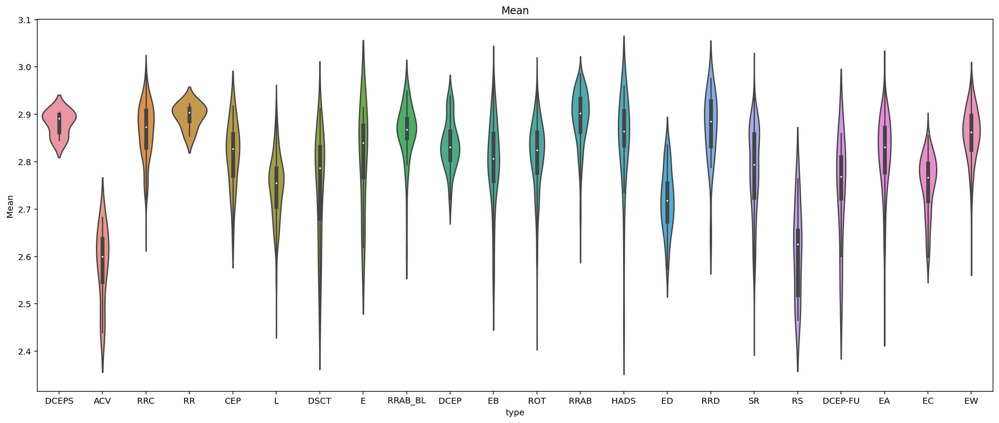

Meanvariance


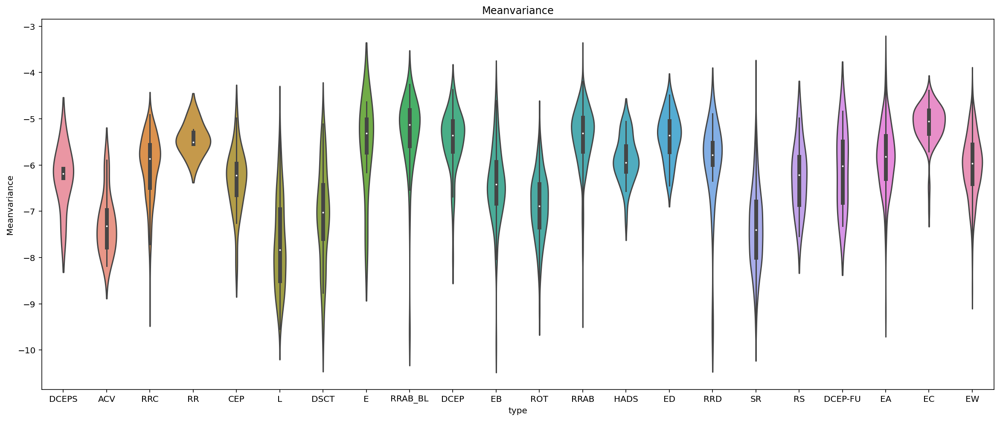

MedianAbsDev


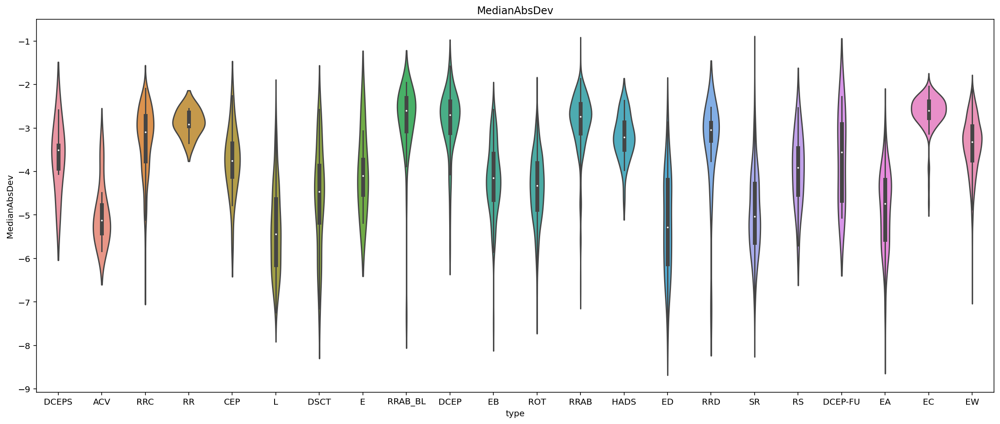

MedianBRP


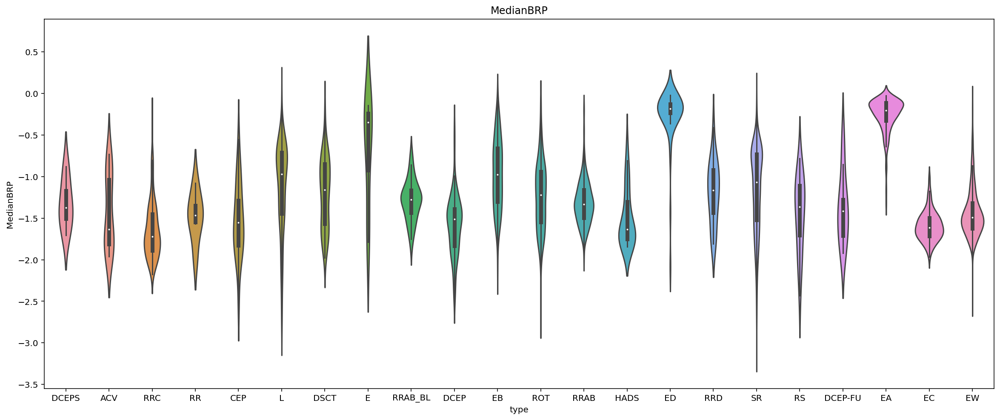

PairSlopeTrend


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


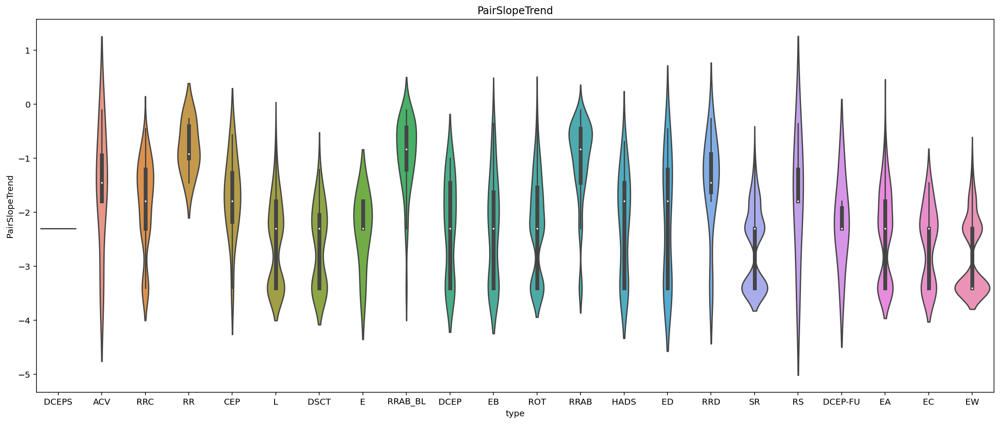

PercentAmplitude


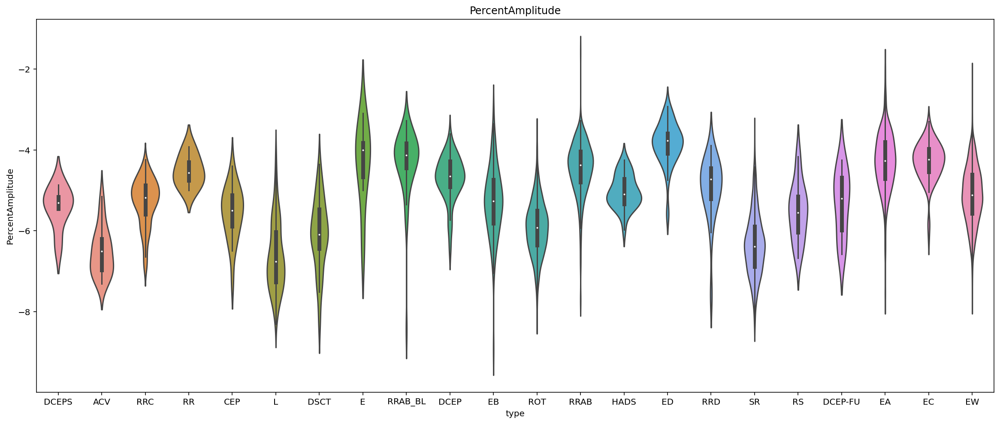

PercentDifferenceFluxPercentile


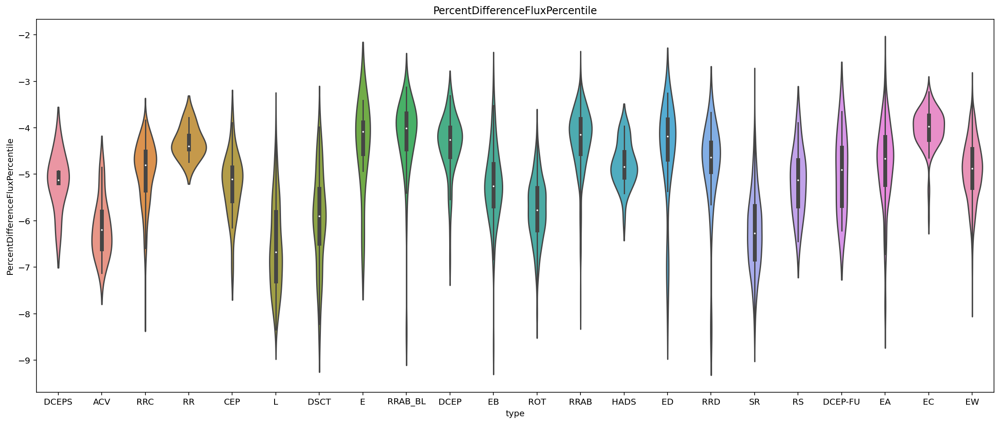

PeriodLS


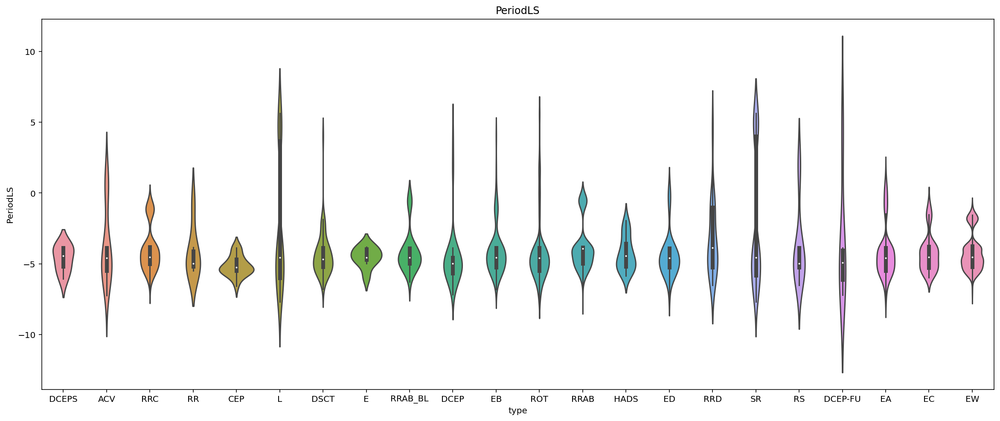

Psi_CS


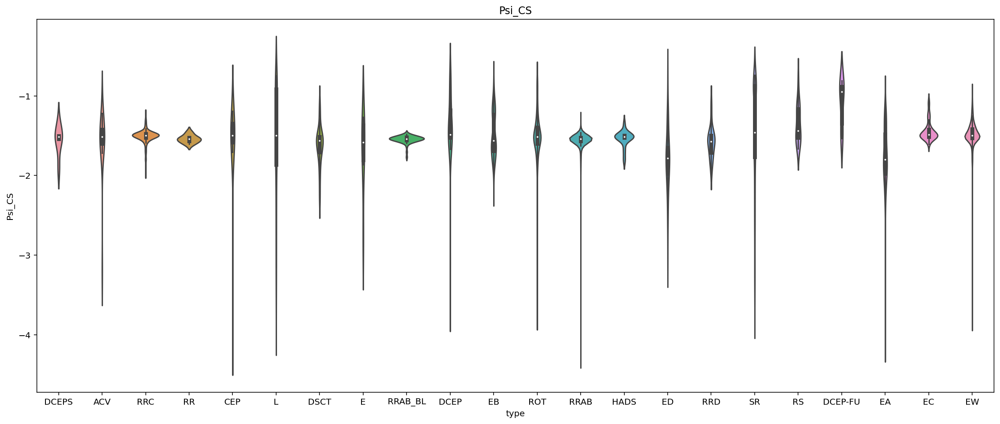

Psi_eta


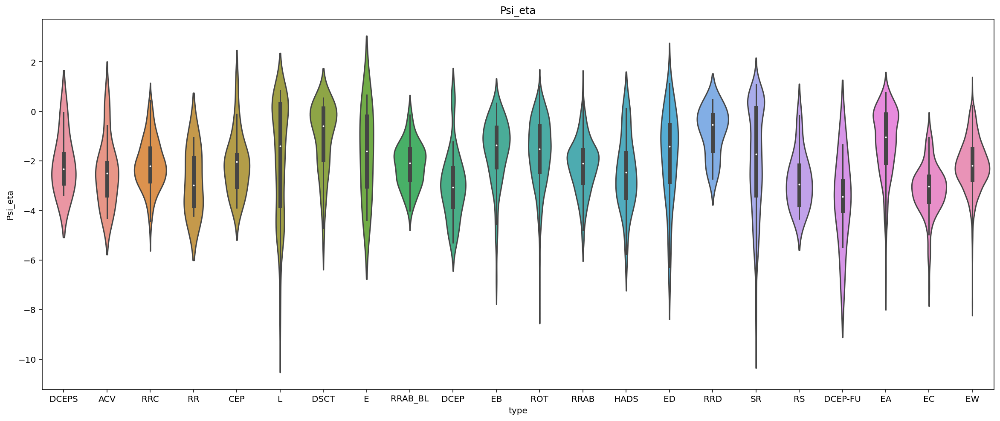

Q31


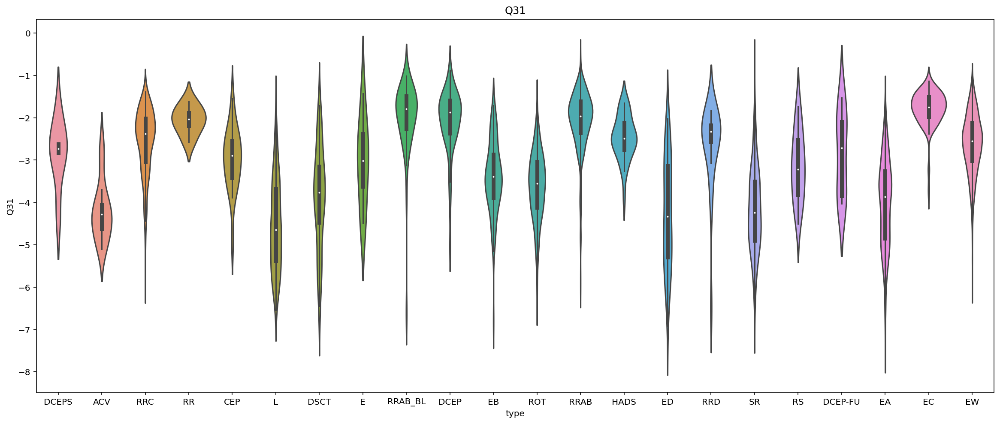

Rcs


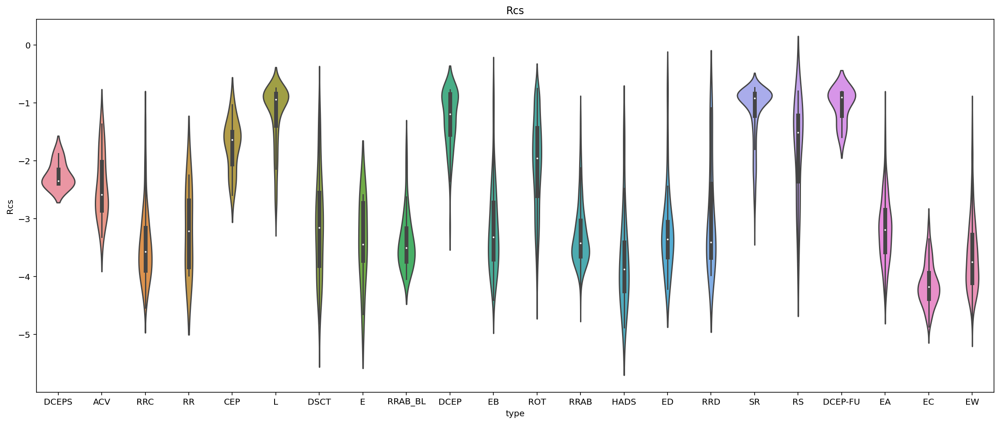

Skew


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


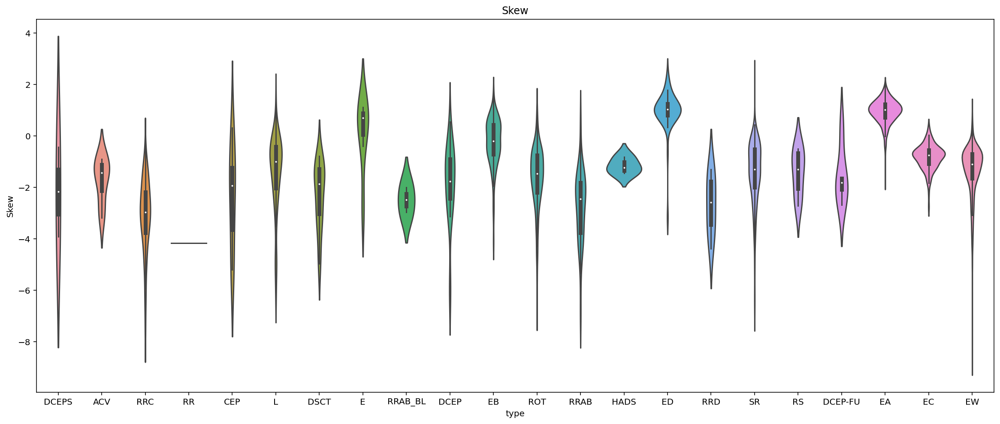

SlottedA_length


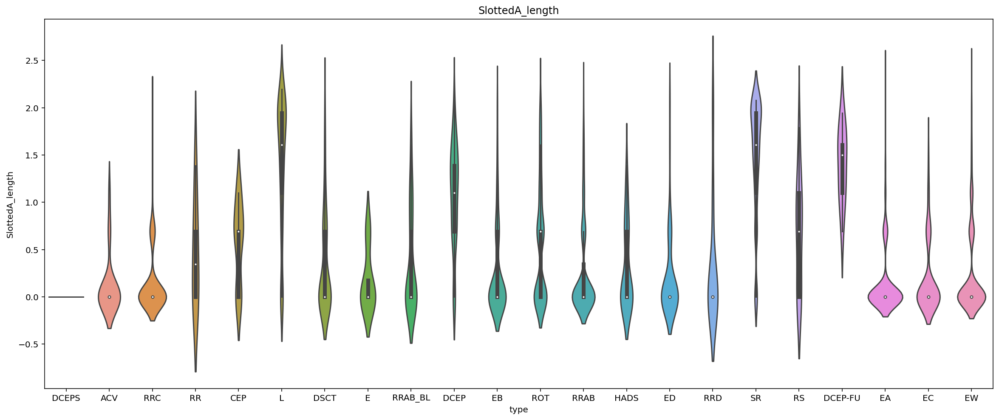

SmallKurtosis


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


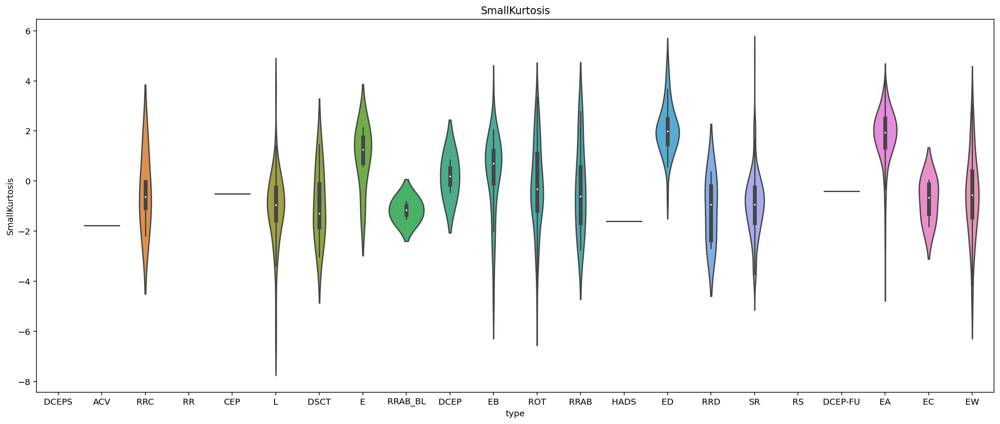

Std


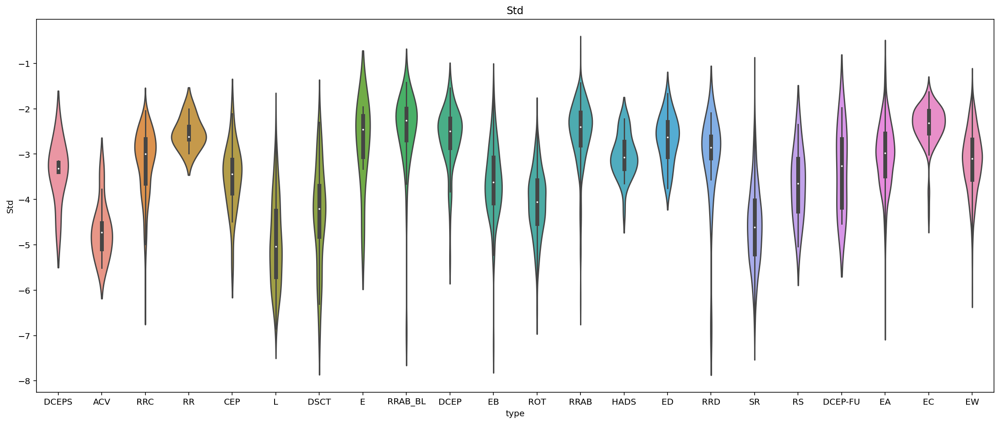

StructureFunction_index_21


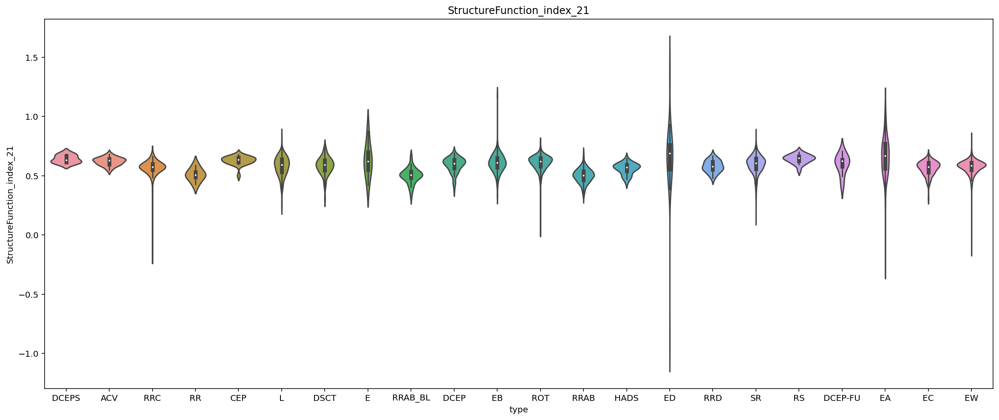

StructureFunction_index_31


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


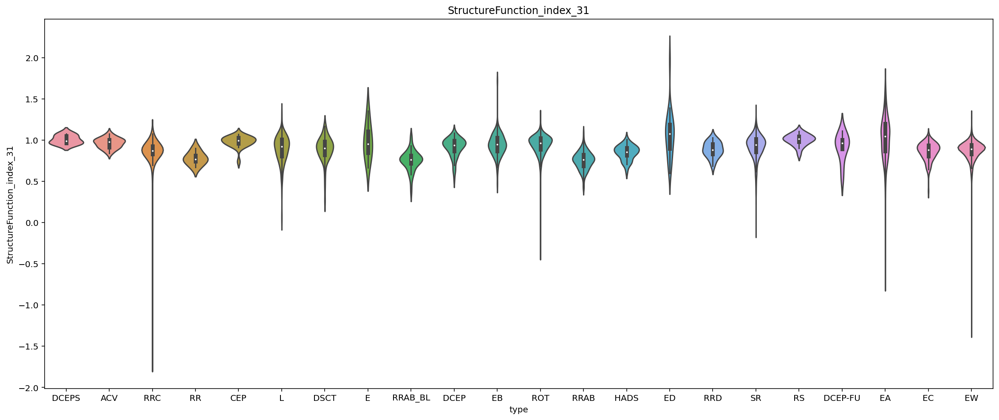

StructureFunction_index_32


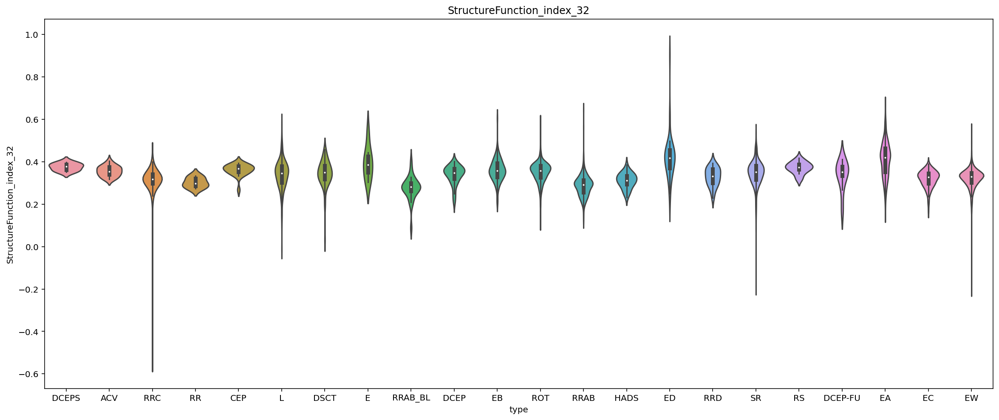

In [90]:
features = ['Amplitude', 'Autocor_length', 'Beyond1Std', 'CAR_mean',
       #'CAR_sigma',
       'CAR_tau',
       #'Con',
       'Eta_e', 'FluxPercentileRatioMid20',
       'FluxPercentileRatioMid35', 'FluxPercentileRatioMid50',
       'FluxPercentileRatioMid65', 'FluxPercentileRatioMid80',
       'Freq1_harmonics_amplitude_0', 'Freq1_harmonics_amplitude_1',
       'Freq1_harmonics_amplitude_2', 'Freq1_harmonics_amplitude_3',
       'Freq1_harmonics_rel_phase_0', 'Freq1_harmonics_rel_phase_1',
       'Freq1_harmonics_rel_phase_2', 'Freq1_harmonics_rel_phase_3',
       'Freq2_harmonics_amplitude_0', 'Freq2_harmonics_amplitude_1',
       'Freq2_harmonics_amplitude_2', 'Freq2_harmonics_amplitude_3',
       'Freq2_harmonics_rel_phase_0', 'Freq2_harmonics_rel_phase_1',
       'Freq2_harmonics_rel_phase_2', 'Freq2_harmonics_rel_phase_3',
       'Freq3_harmonics_amplitude_0', 'Freq3_harmonics_amplitude_1',
       'Freq3_harmonics_amplitude_2', 'Freq3_harmonics_amplitude_3',
       'Freq3_harmonics_rel_phase_0', 'Freq3_harmonics_rel_phase_1',
       'Freq3_harmonics_rel_phase_2', 'Freq3_harmonics_rel_phase_3', 'Gskew',
       'LinearTrend', 'MaxSlope', 'Mean', 'Meanvariance', 'MedianAbsDev',
       'MedianBRP', 'PairSlopeTrend', 'PercentAmplitude',
       'PercentDifferenceFluxPercentile', 'PeriodLS',
       # 'Period_fit',
       'Psi_CS',
       'Psi_eta', 'Q31', 'Rcs', 'Skew', 'SlottedA_length', 'SmallKurtosis',
       'Std', 'StructureFunction_index_21', 'StructureFunction_index_31',
       'StructureFunction_index_32']

# plot log(features)
for feature in features:
    print(feature)
    plt.figure(figsize=(20, 8))
    sns.violinplot(x="type", y=np.log(df[feature]), data=df)
    plt.title(f"{feature}")
    plt.show()

Amplitude


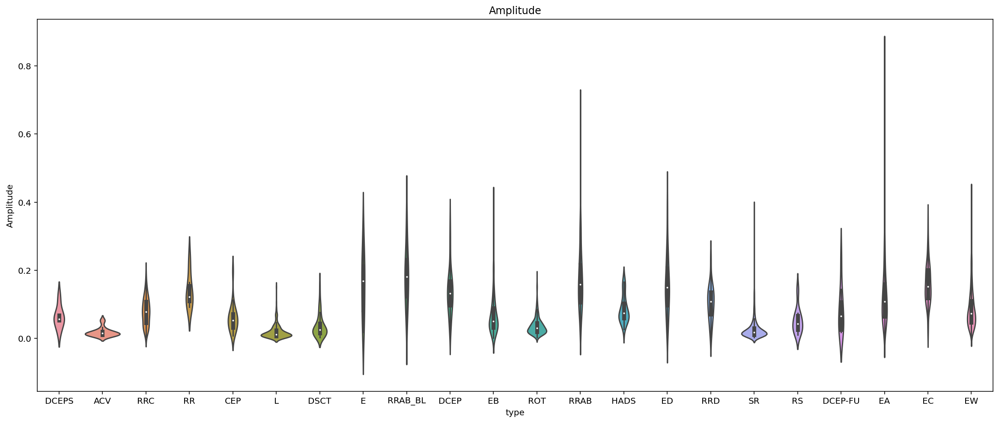

Autocor_length


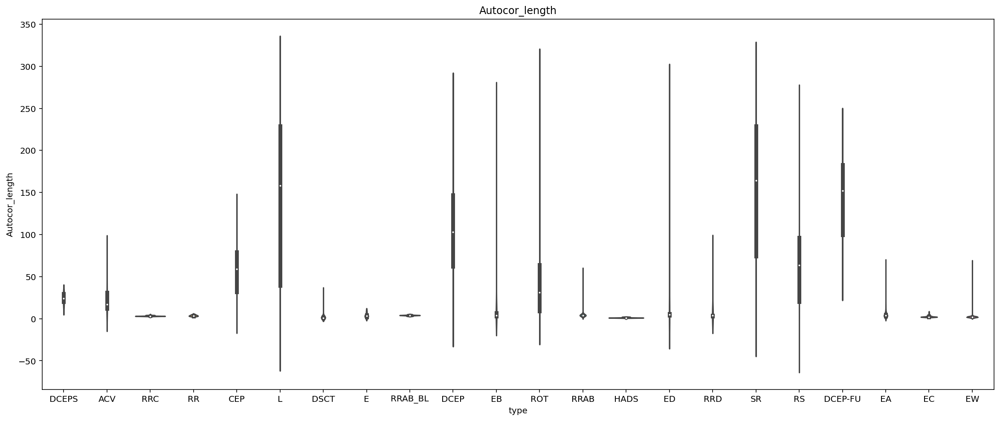

Beyond1Std


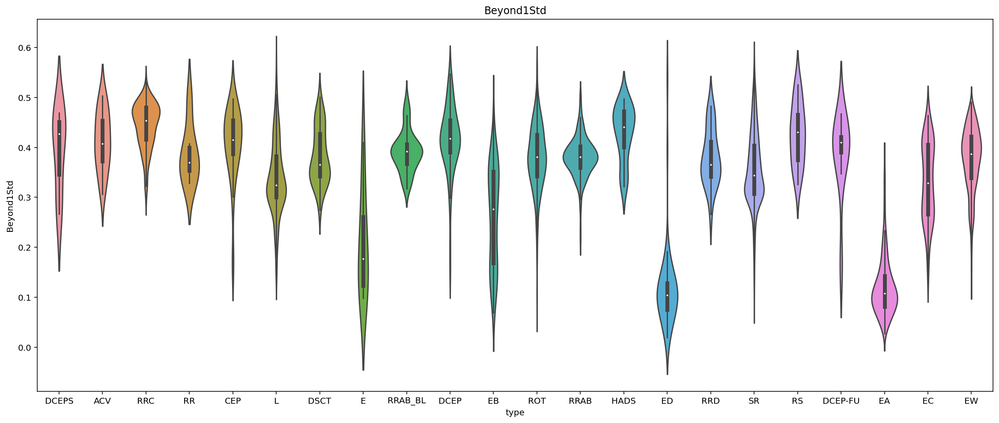

CAR_mean


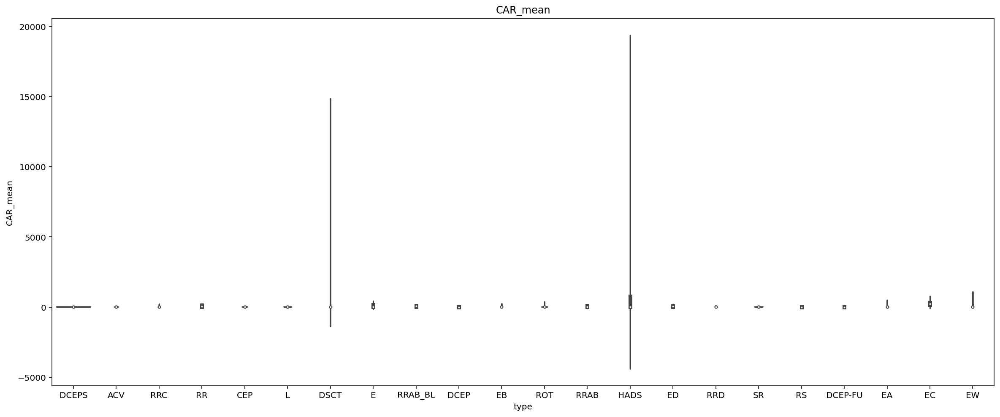

CAR_sigma


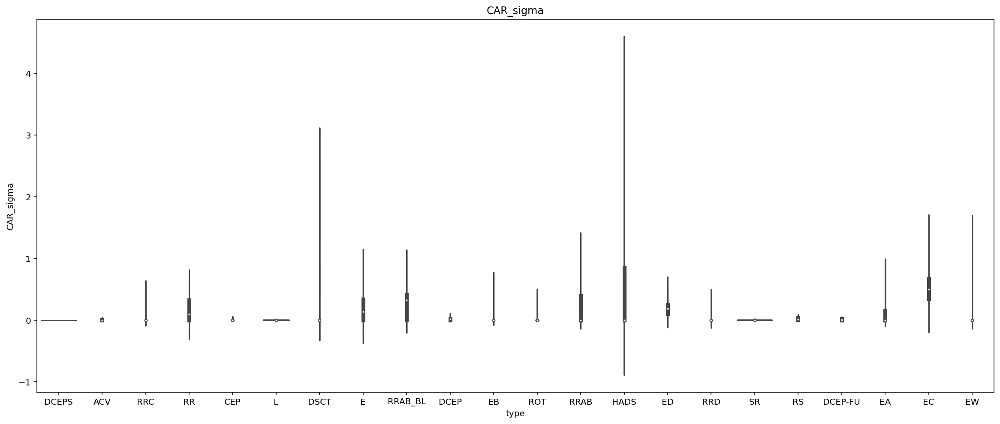

CAR_tau


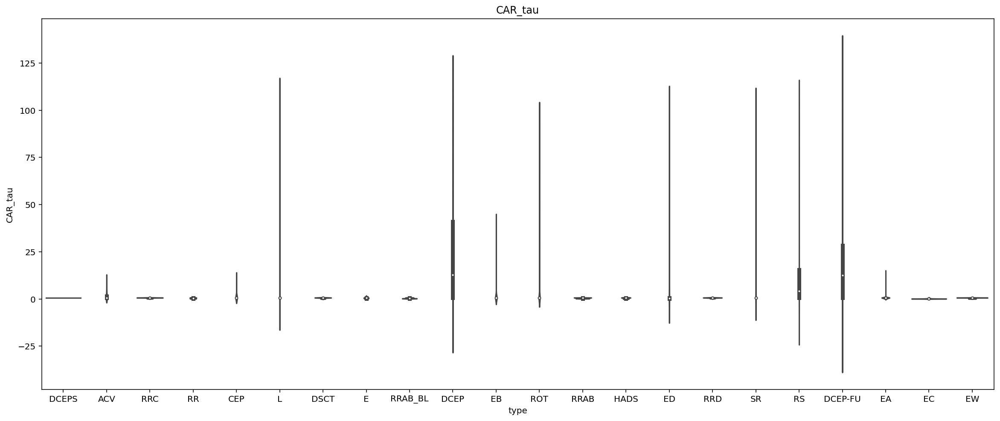

Con


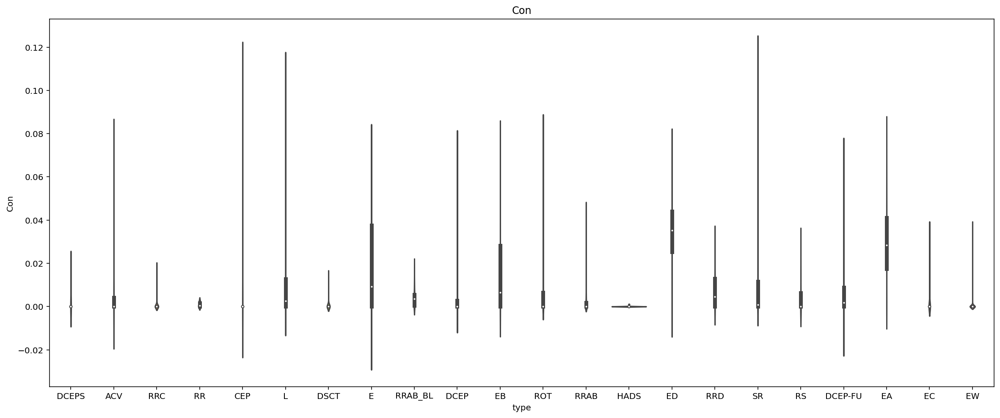

Eta_e


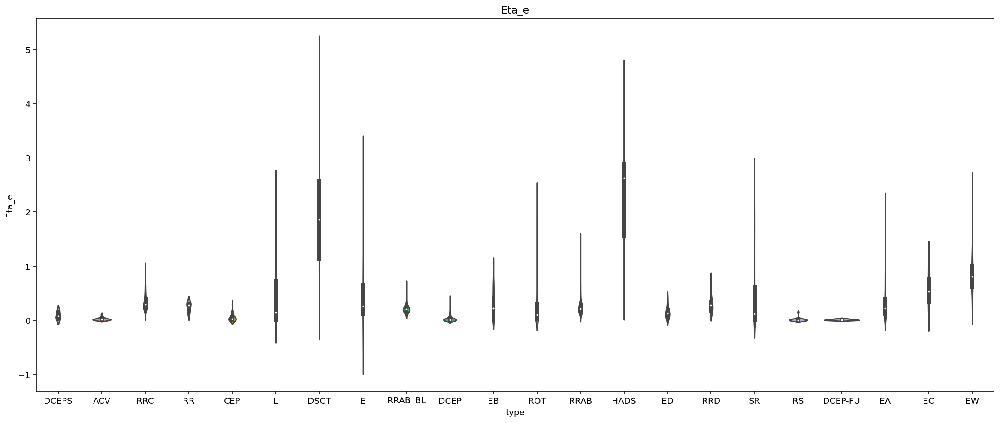

FluxPercentileRatioMid20


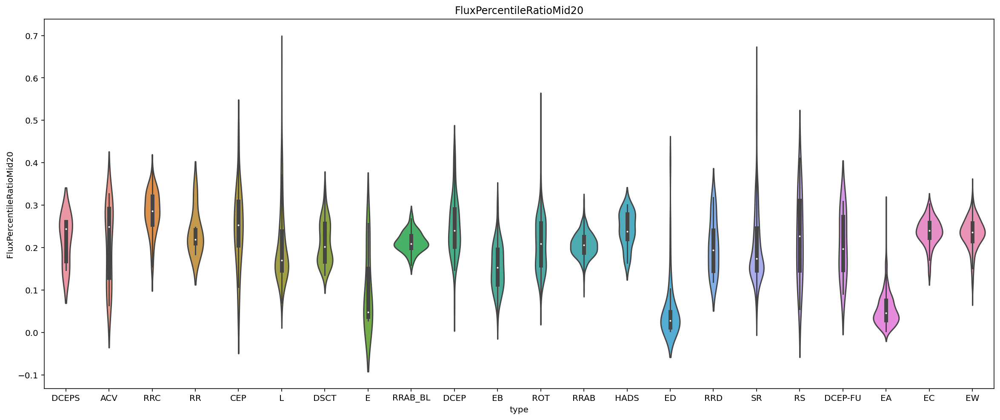

FluxPercentileRatioMid35


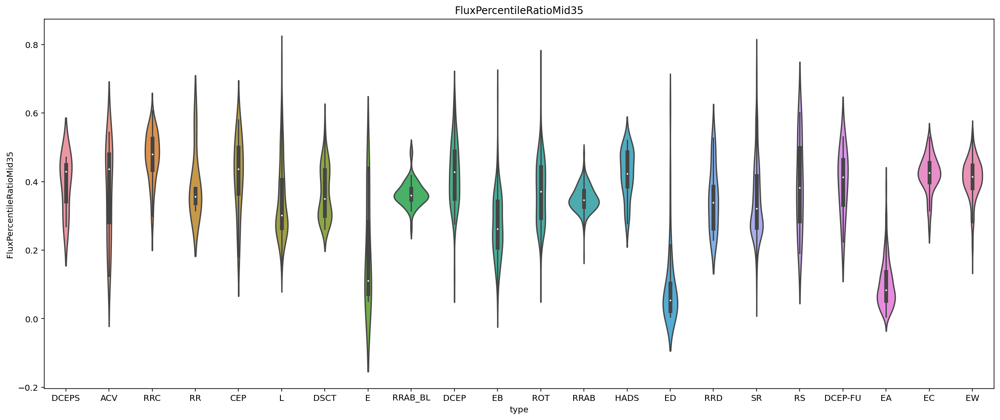

FluxPercentileRatioMid50


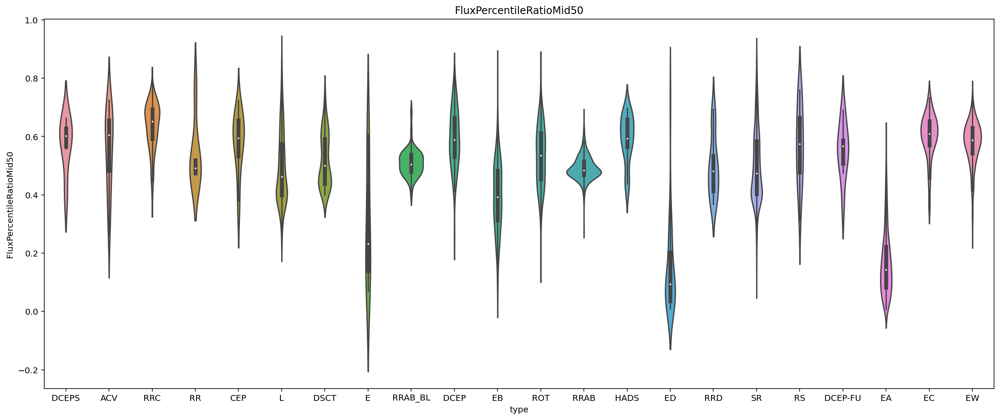

FluxPercentileRatioMid65


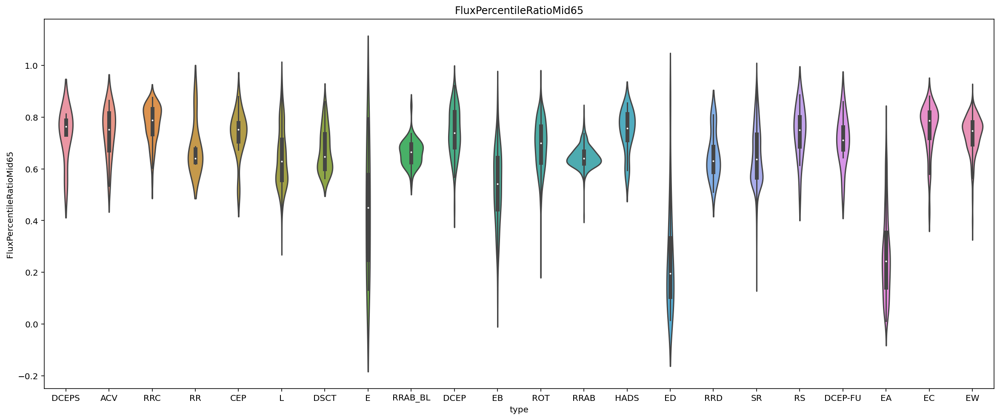

FluxPercentileRatioMid80


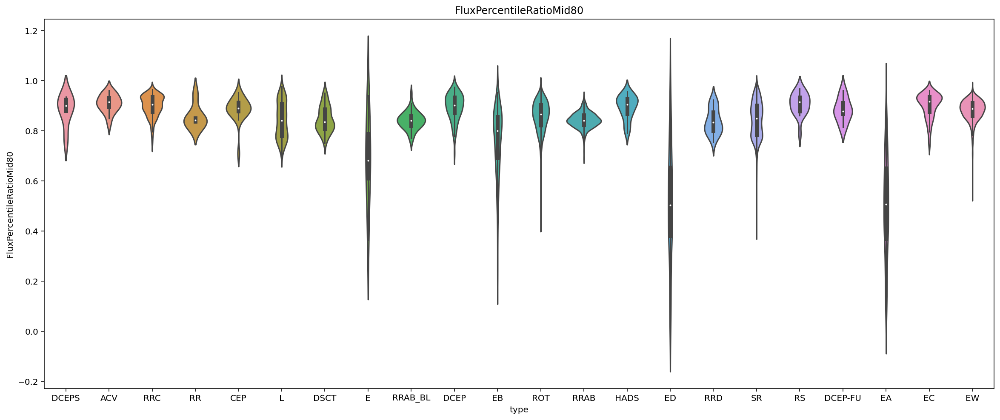

Freq1_harmonics_amplitude_0


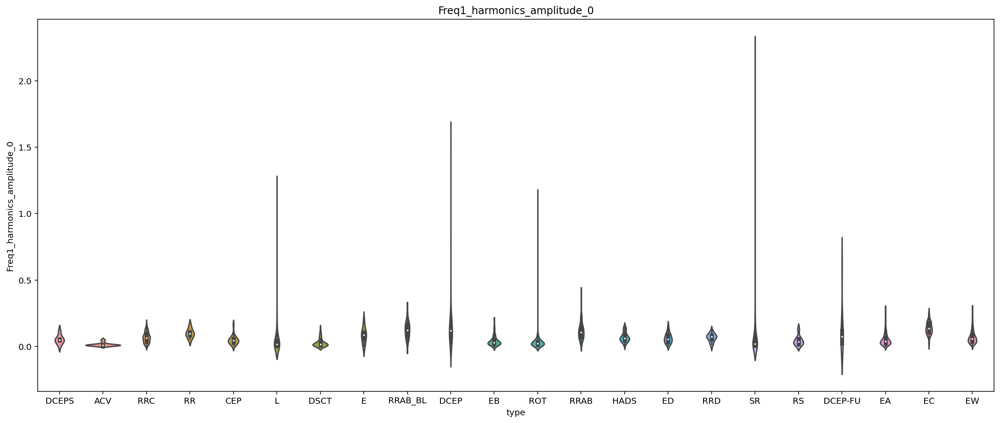

Freq1_harmonics_amplitude_1


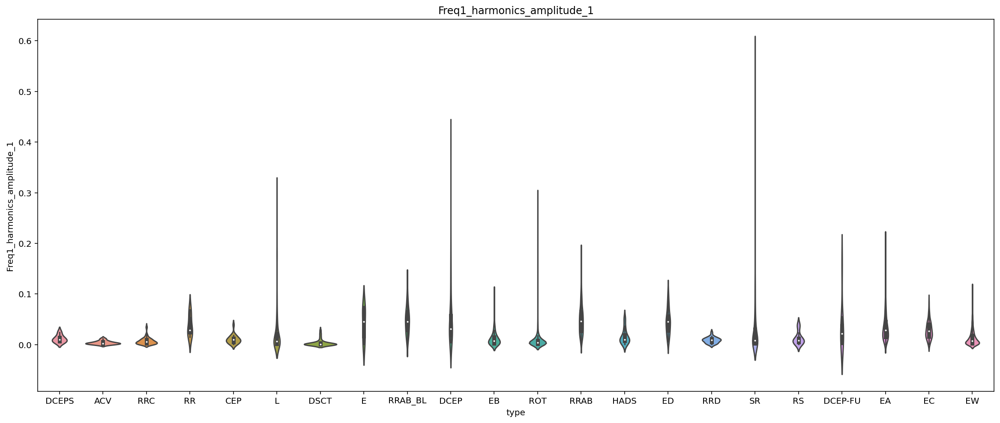

Freq1_harmonics_amplitude_2


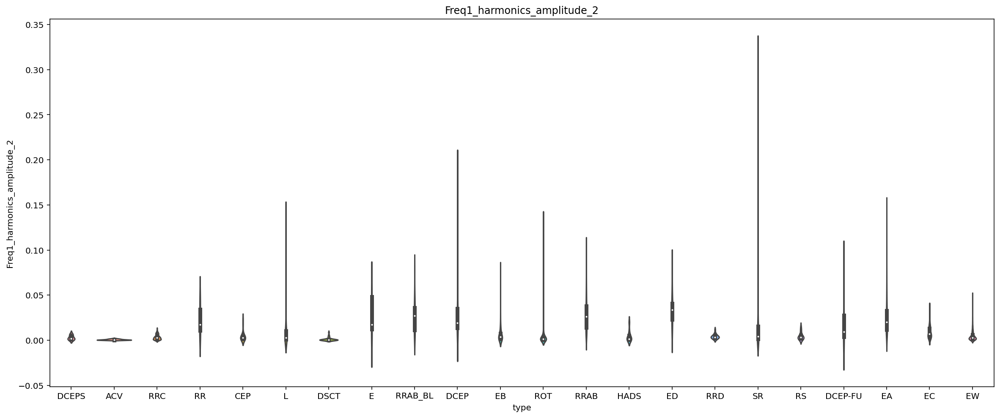

Freq1_harmonics_amplitude_3


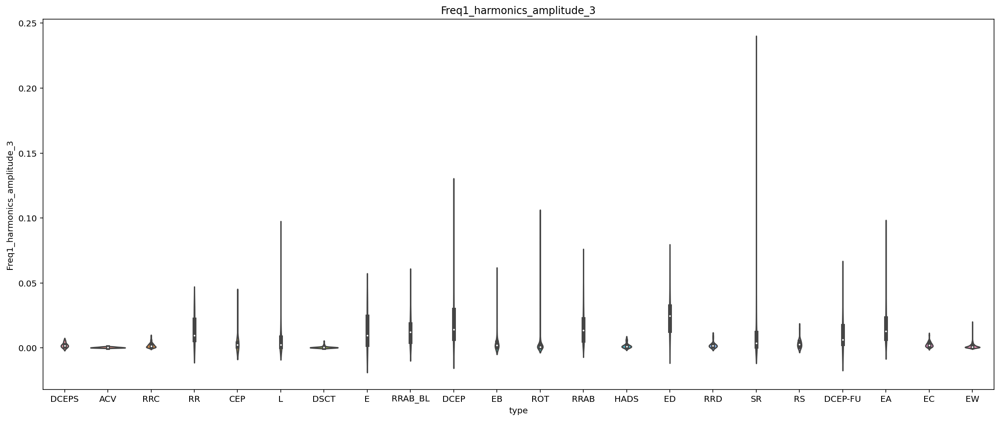

Freq1_harmonics_rel_phase_0


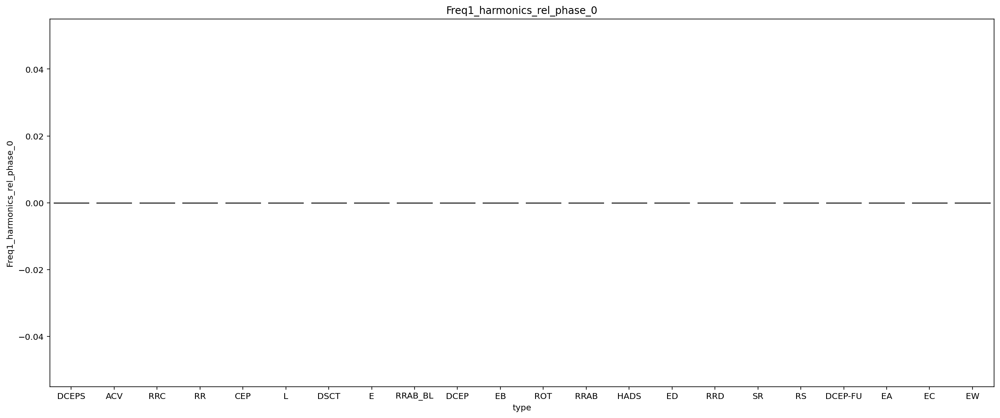

Freq1_harmonics_rel_phase_1


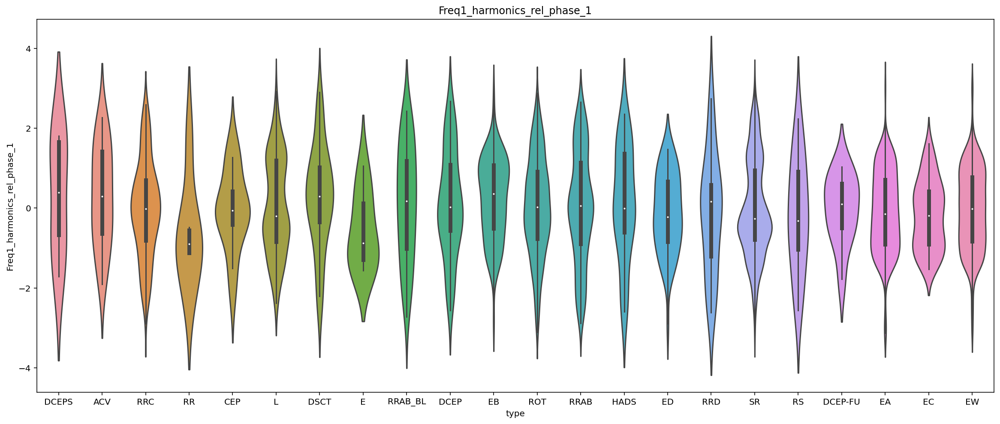

Freq1_harmonics_rel_phase_2


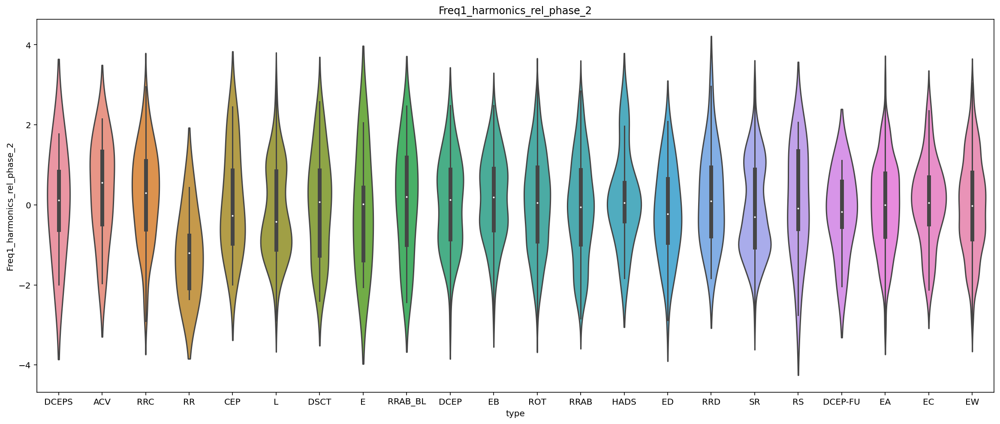

Freq1_harmonics_rel_phase_3


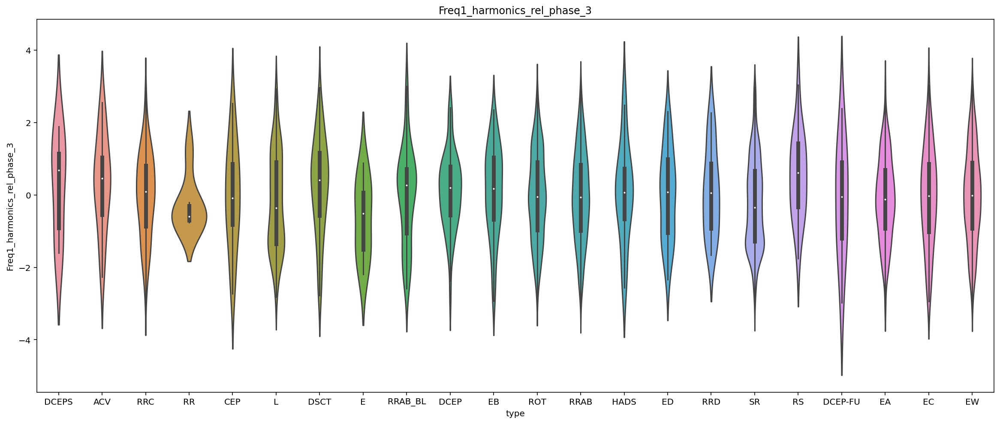

Freq2_harmonics_amplitude_0


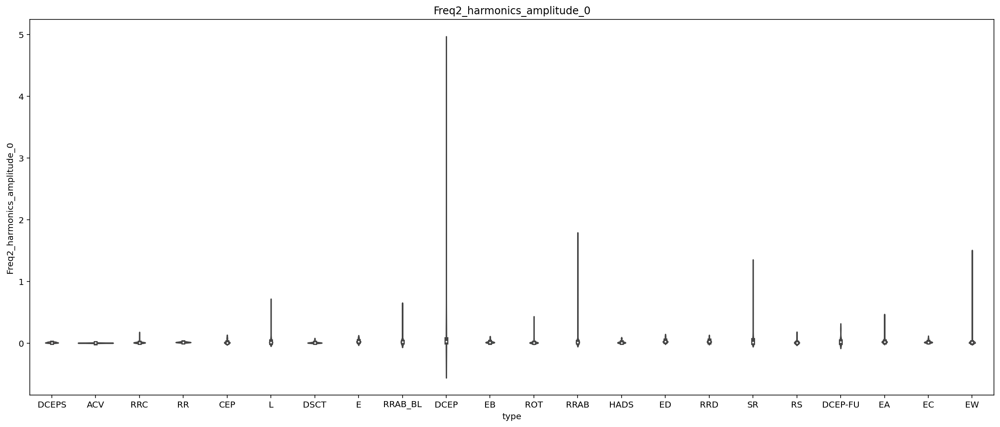

Freq2_harmonics_amplitude_1


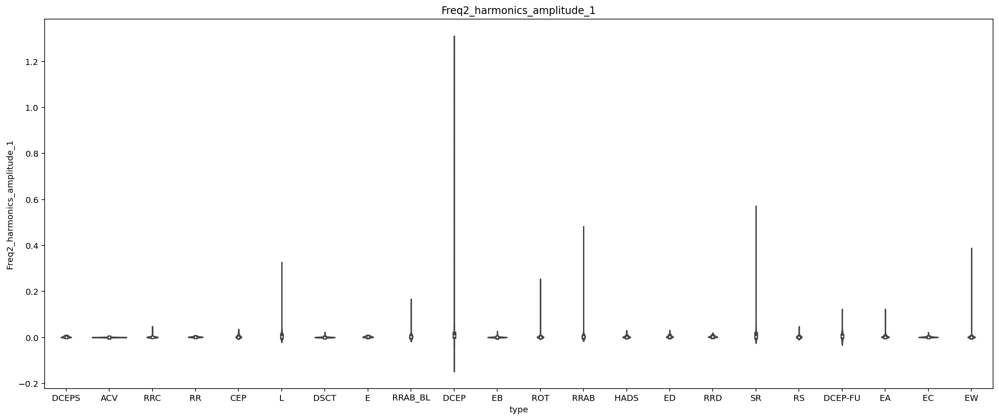

Freq2_harmonics_amplitude_2


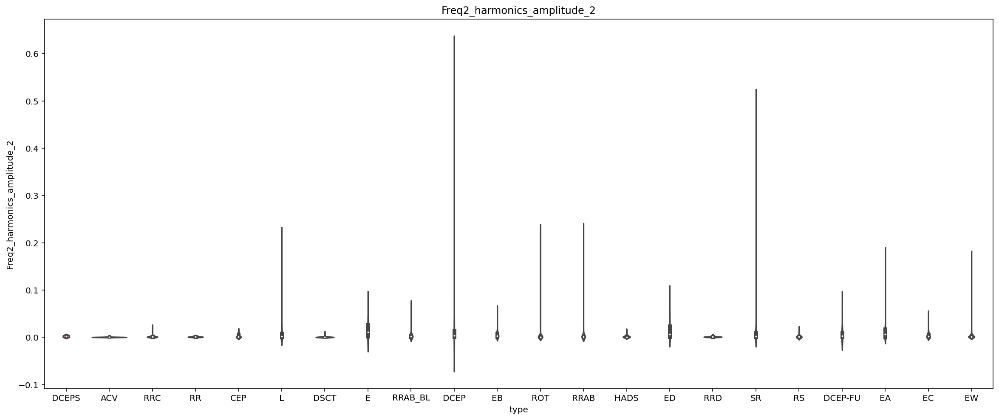

Freq2_harmonics_amplitude_3


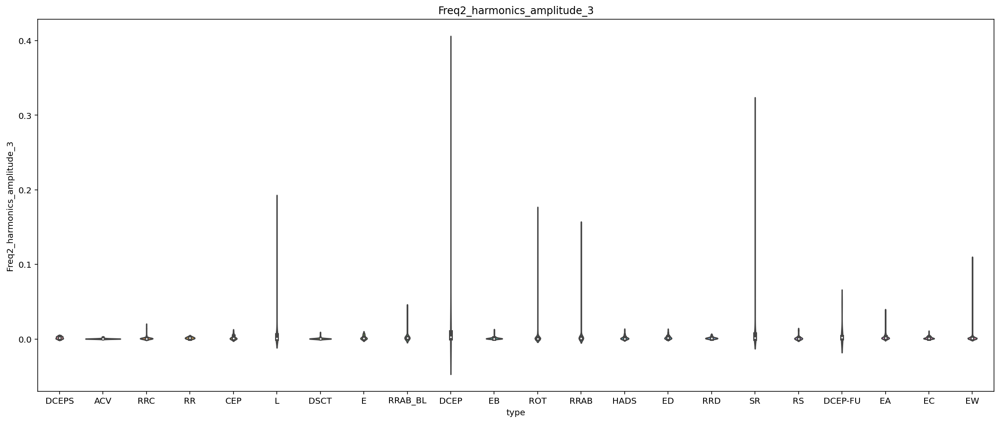

Freq2_harmonics_rel_phase_0


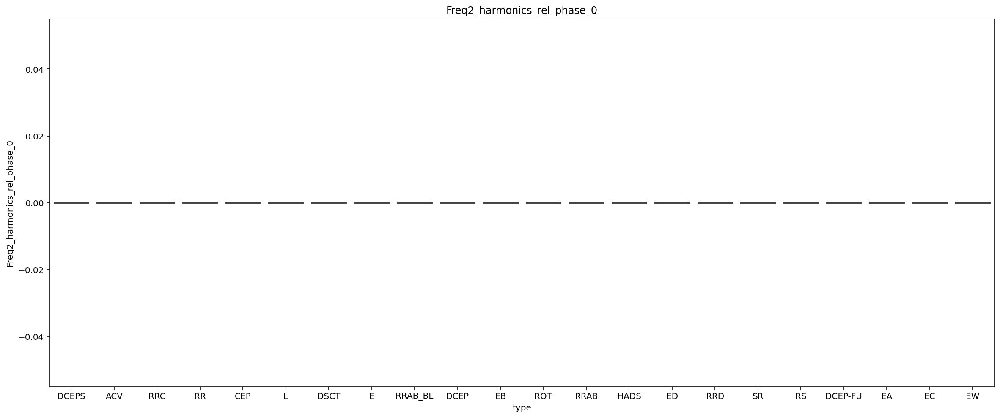

Freq2_harmonics_rel_phase_1


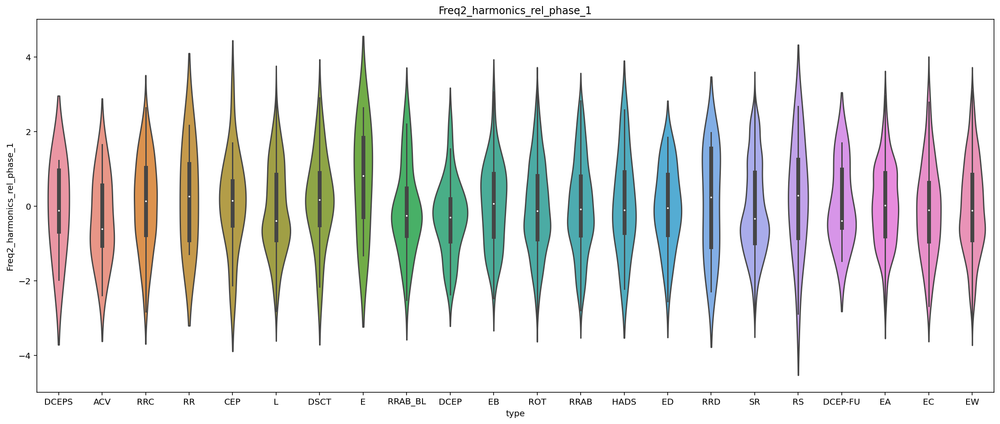

Freq2_harmonics_rel_phase_2


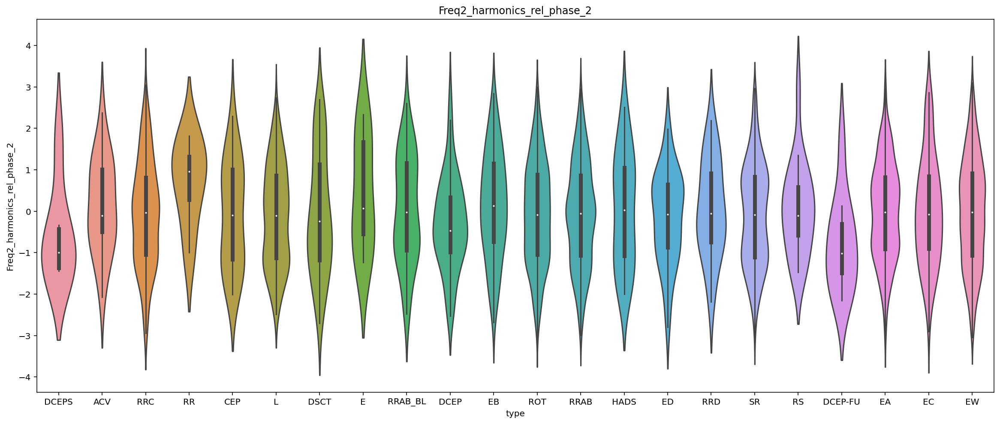

Freq2_harmonics_rel_phase_3


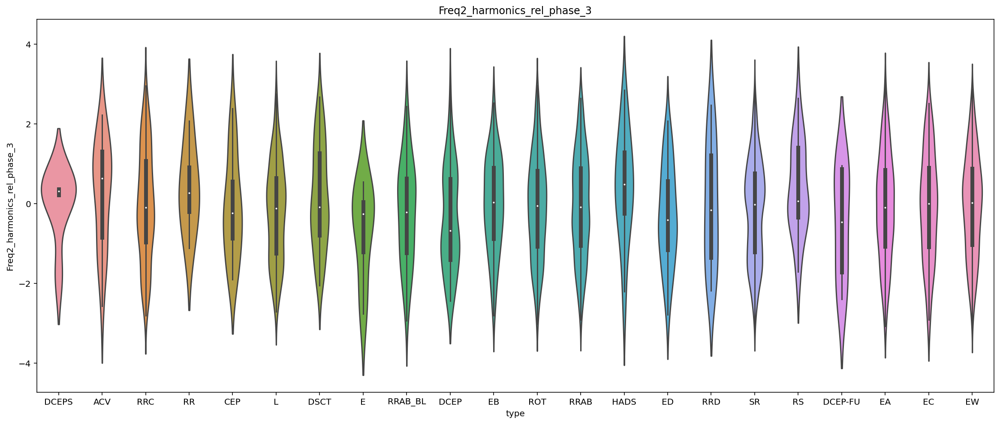

Freq3_harmonics_amplitude_0


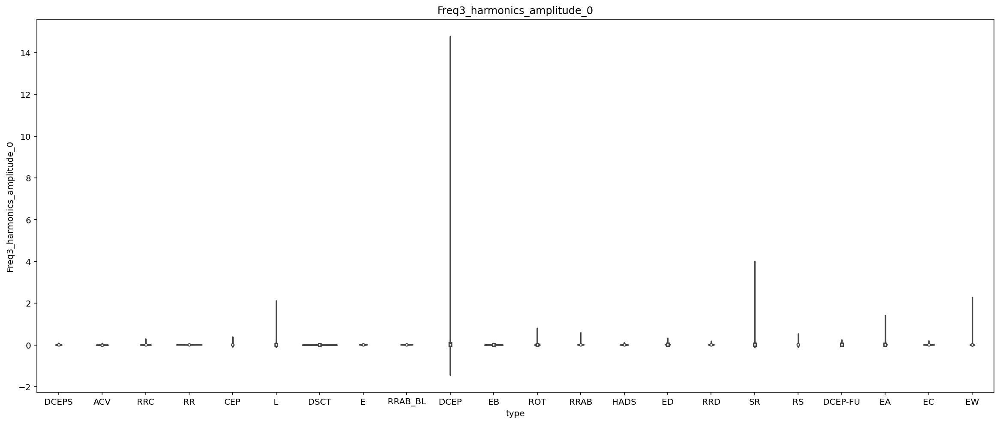

Freq3_harmonics_amplitude_1


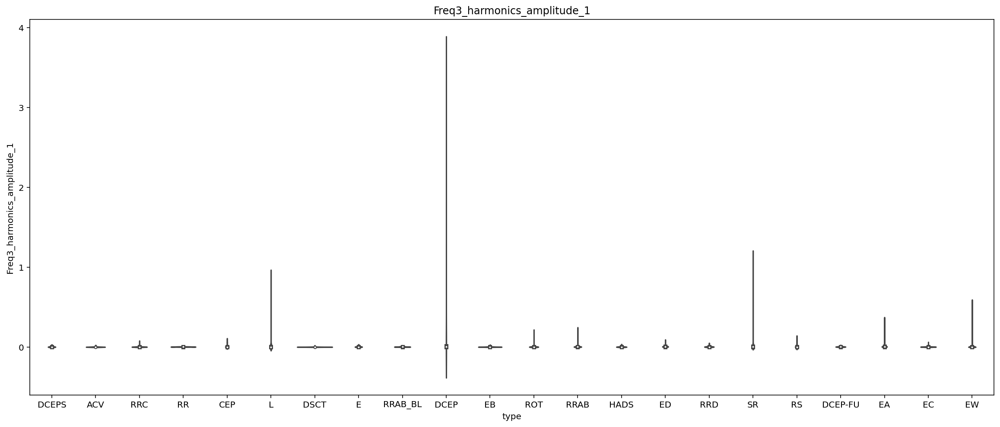

Freq3_harmonics_amplitude_2


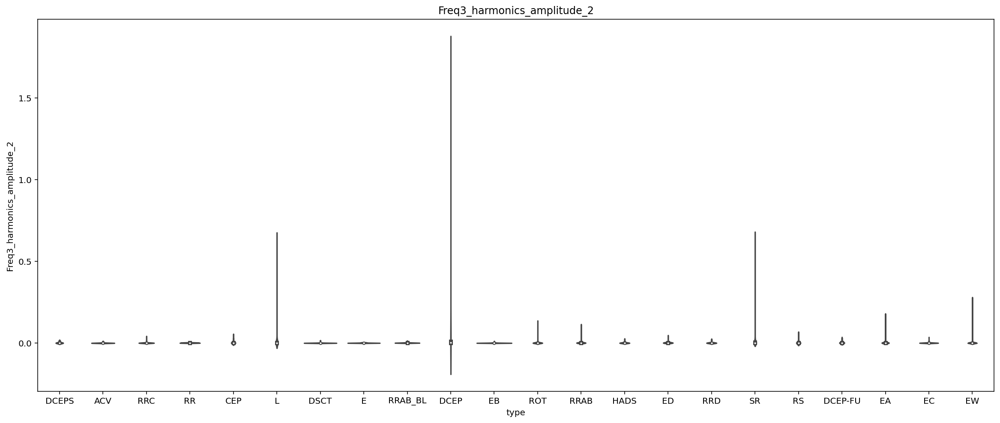

Freq3_harmonics_amplitude_3


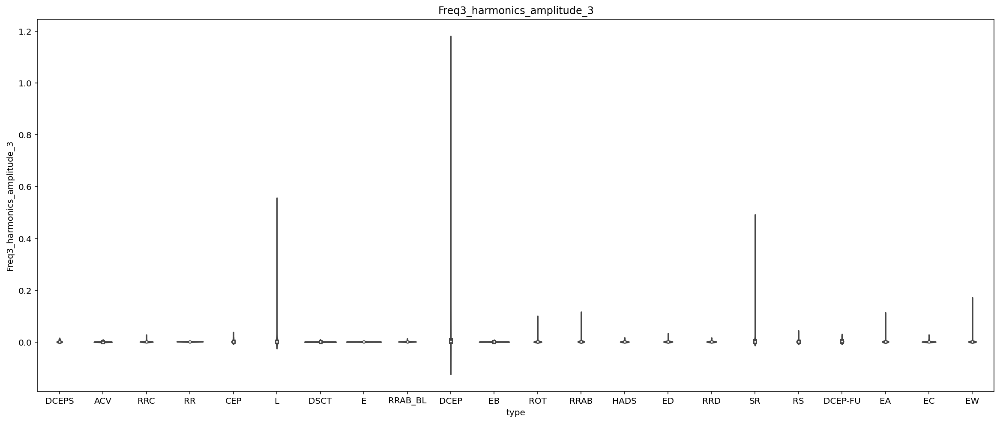

Freq3_harmonics_rel_phase_0


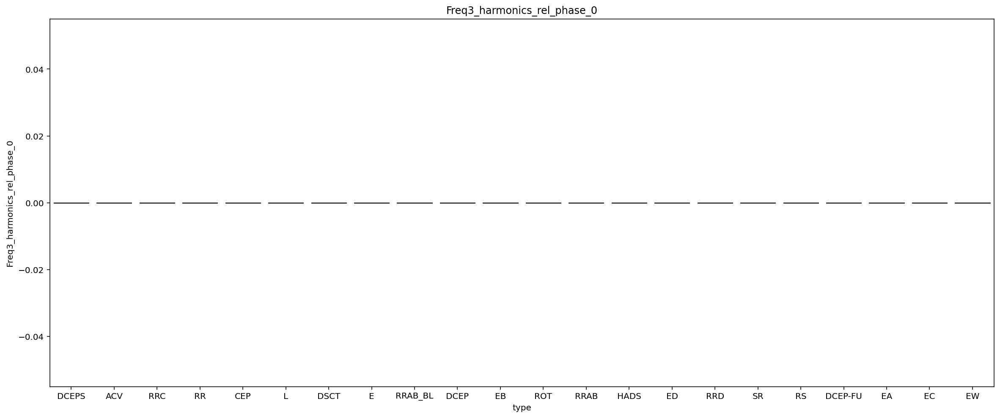

Freq3_harmonics_rel_phase_1


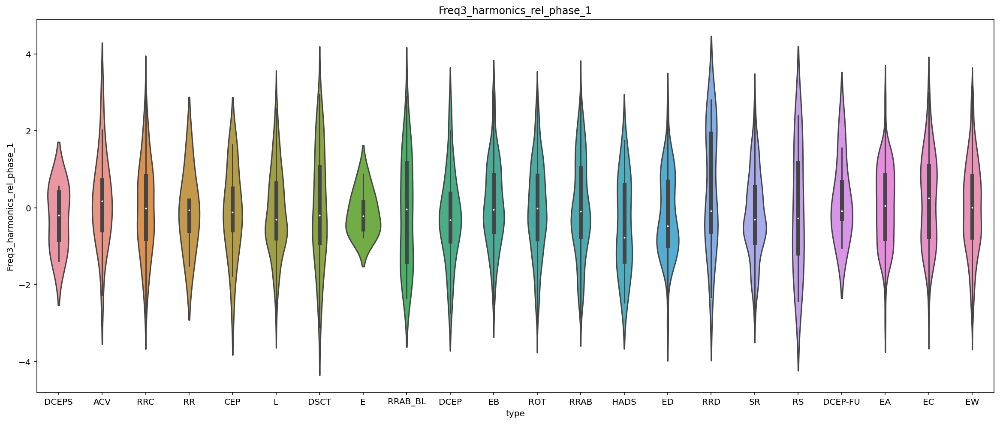

Freq3_harmonics_rel_phase_2


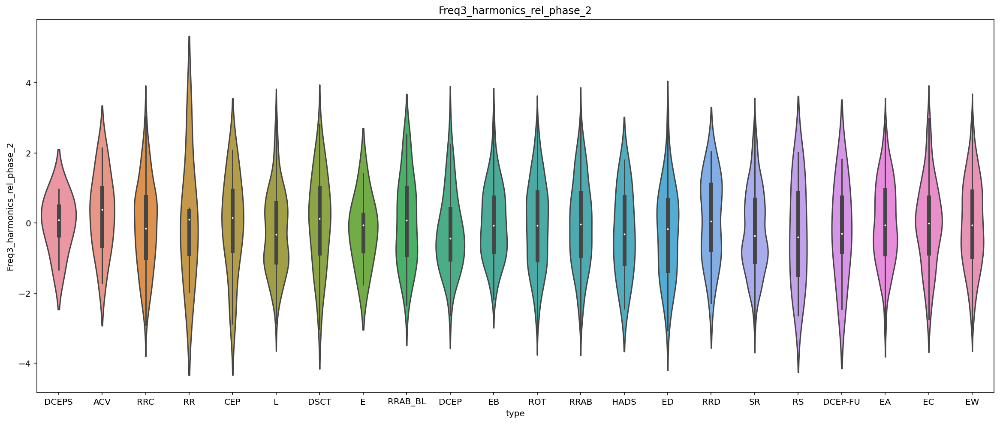

Freq3_harmonics_rel_phase_3


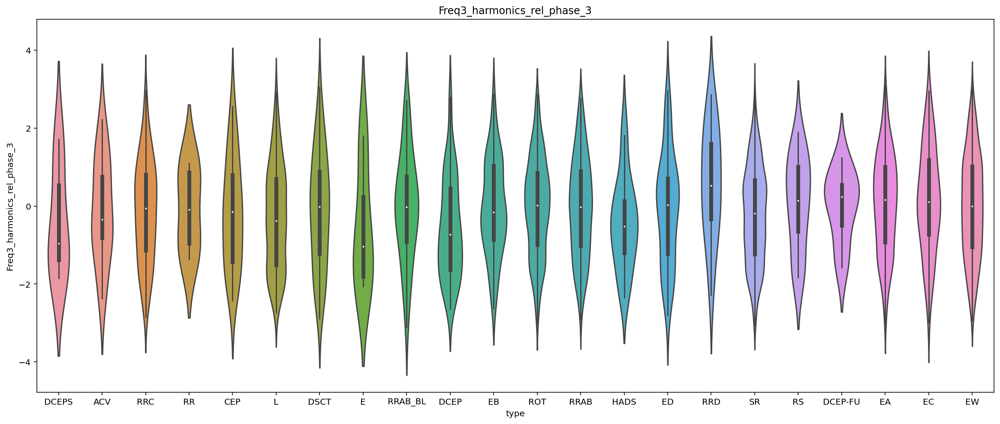

Gskew


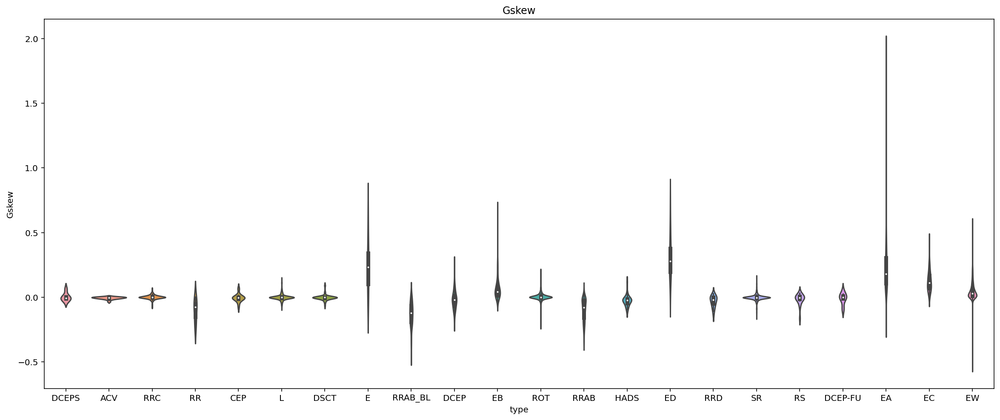

LinearTrend


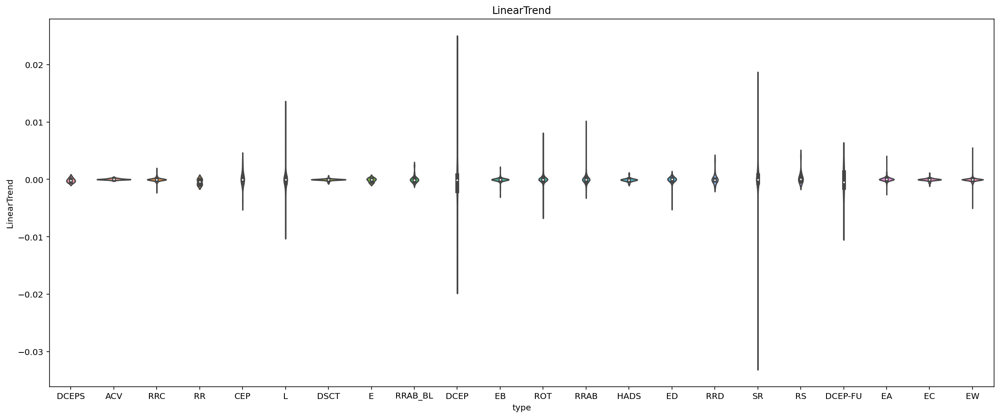

MaxSlope


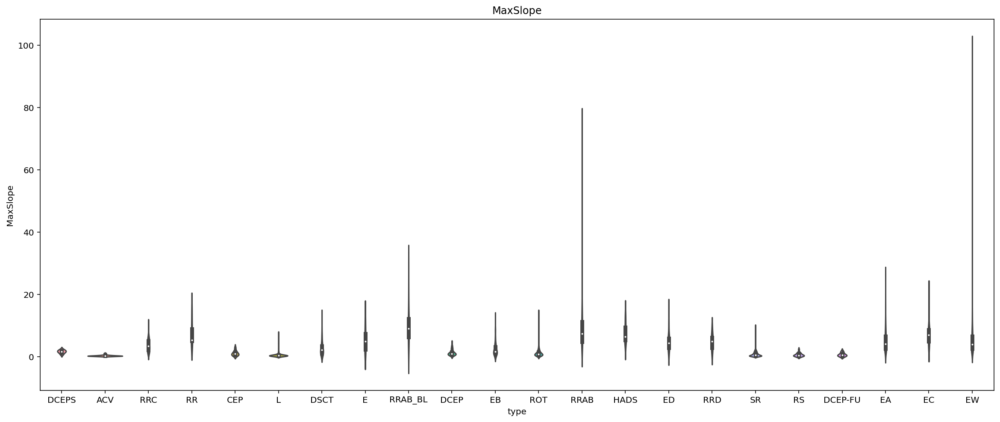

Mean


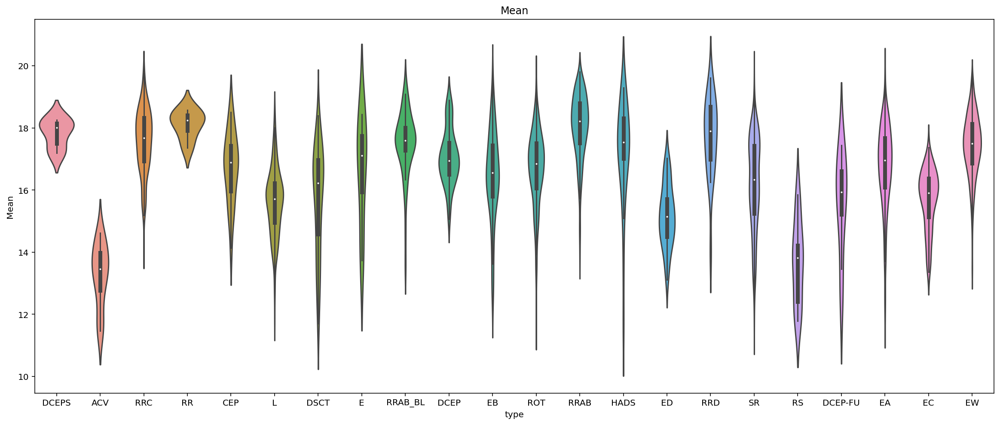

Meanvariance


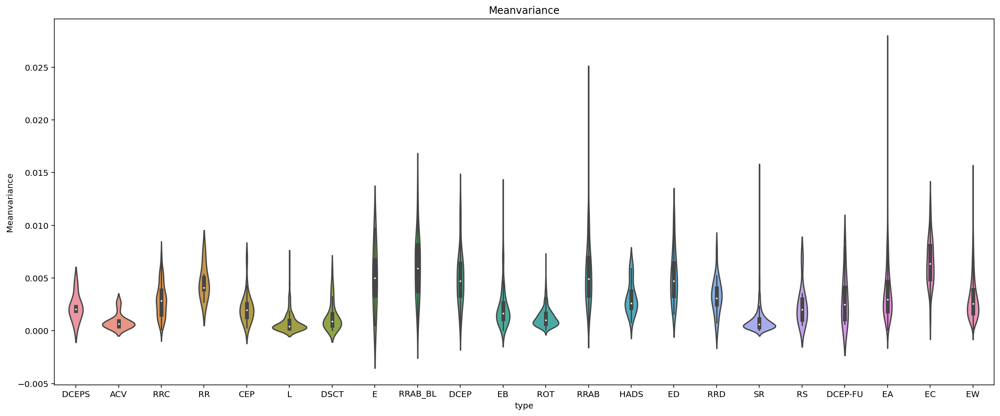

MedianAbsDev


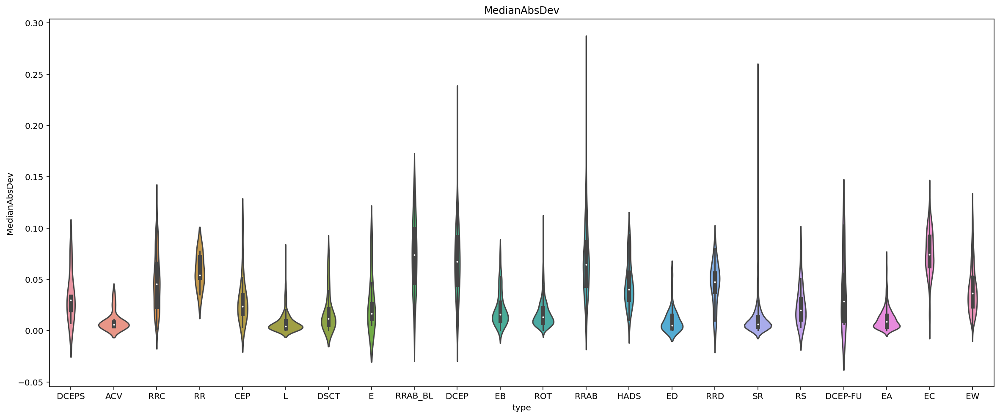

MedianBRP


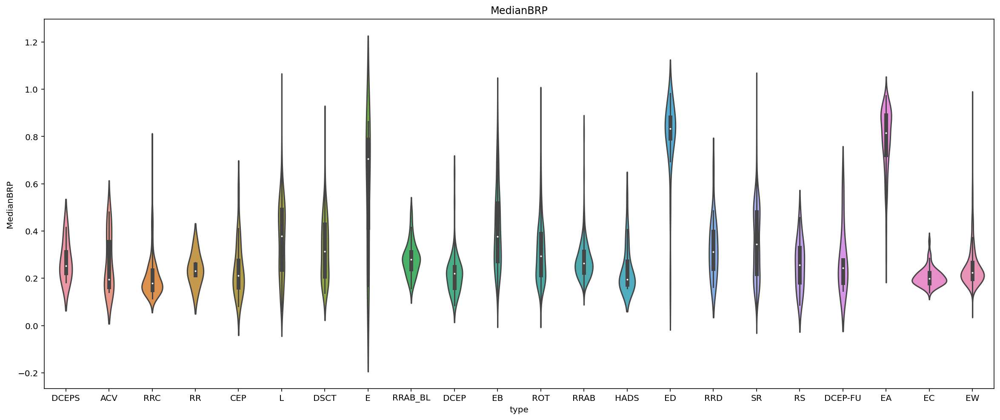

PairSlopeTrend


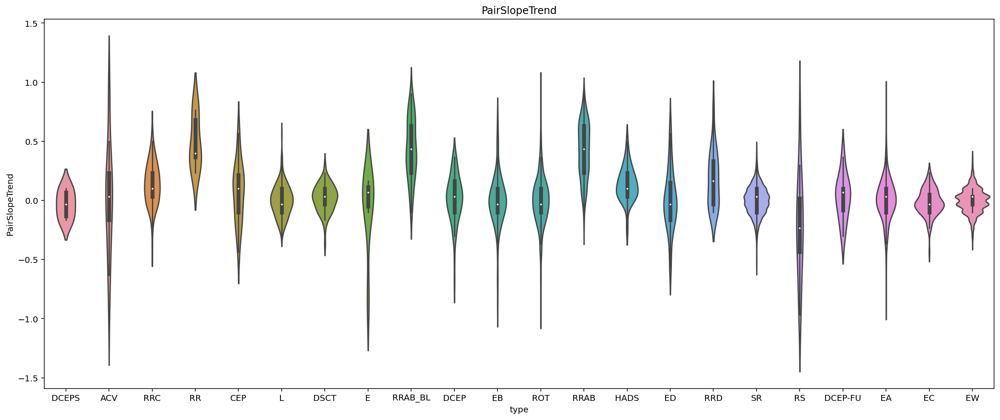

PercentAmplitude


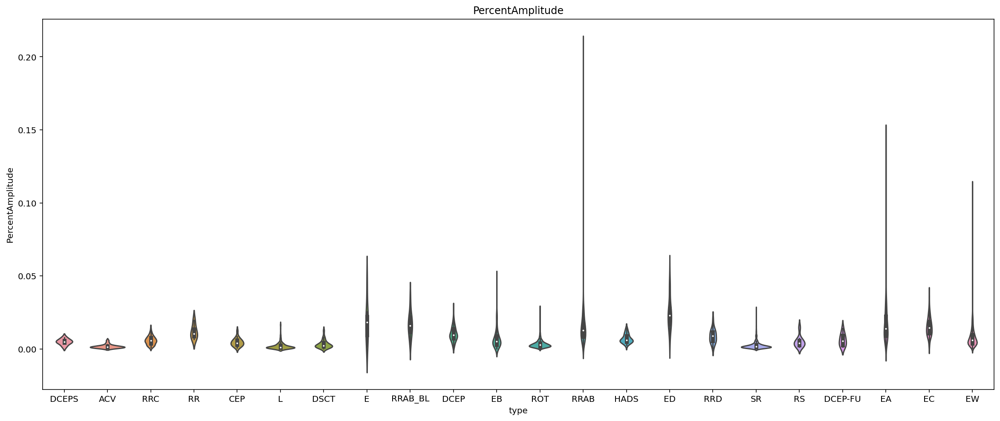

PercentDifferenceFluxPercentile


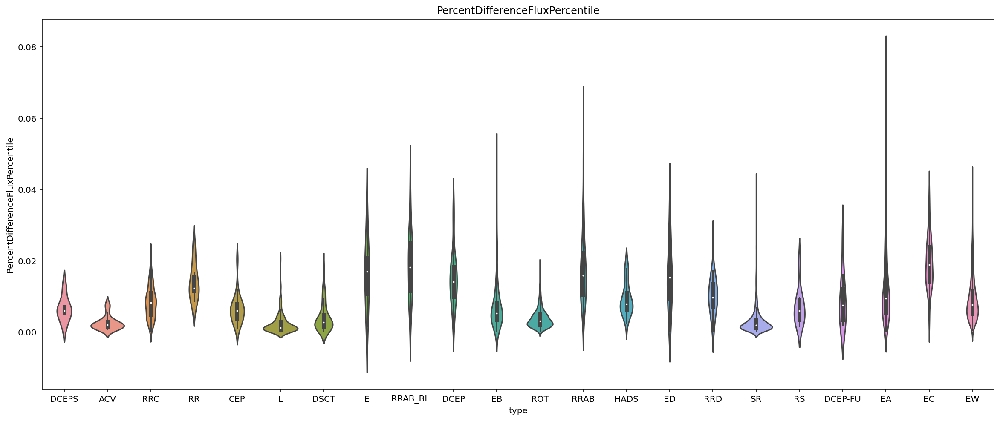

PeriodLS


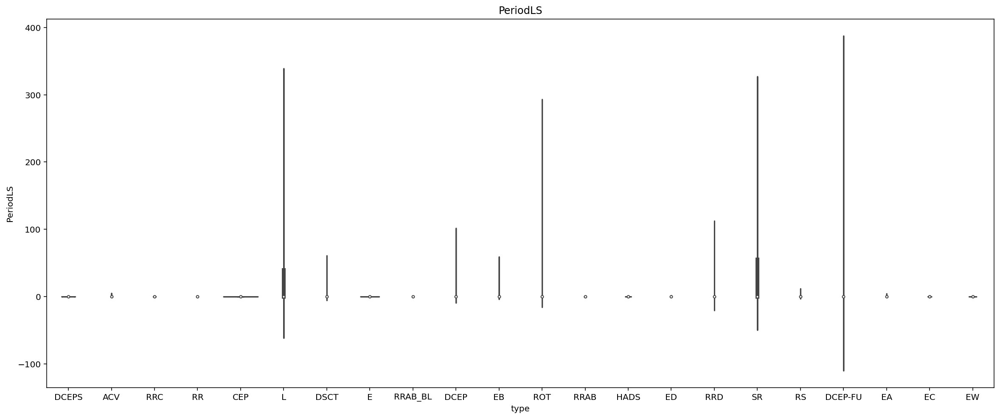

Psi_CS


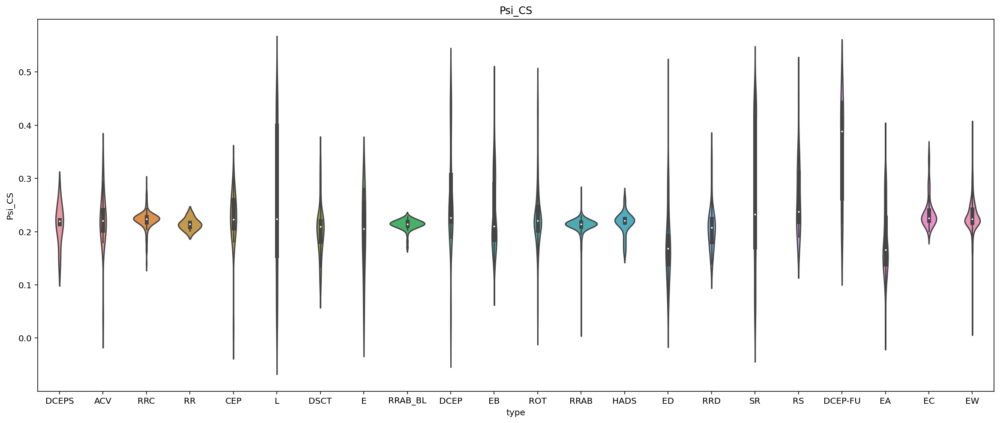

Psi_eta


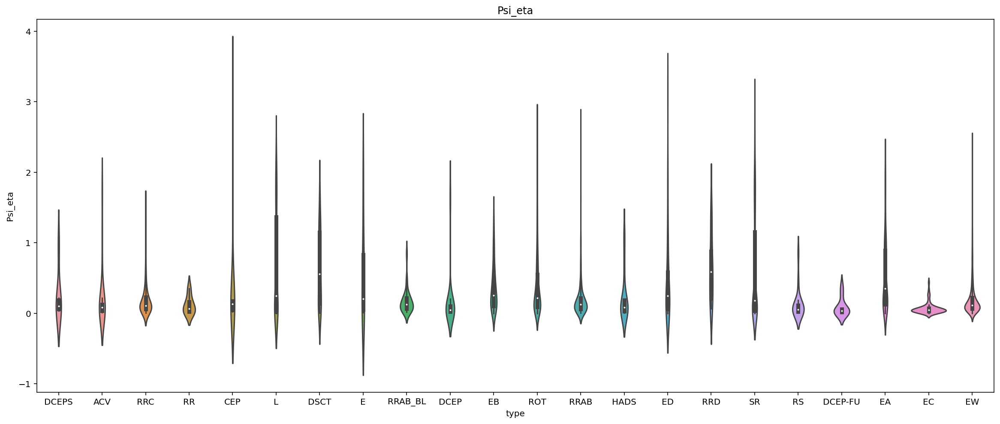

Q31


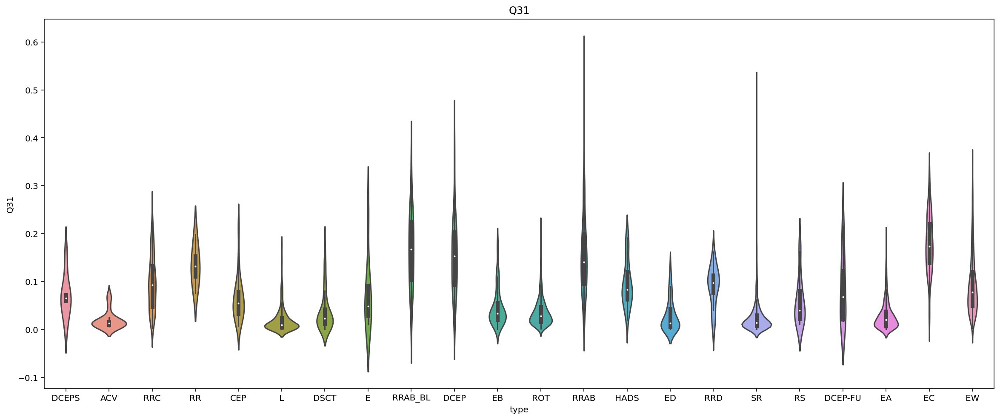

Rcs


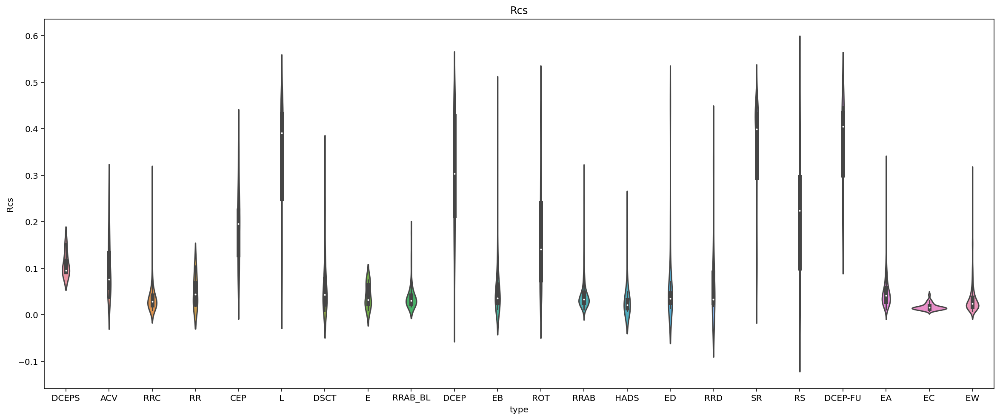

Skew


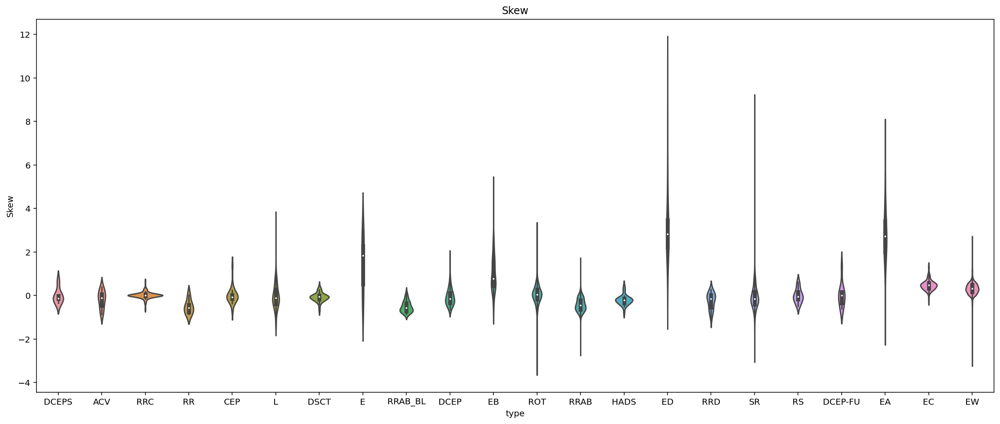

SlottedA_length


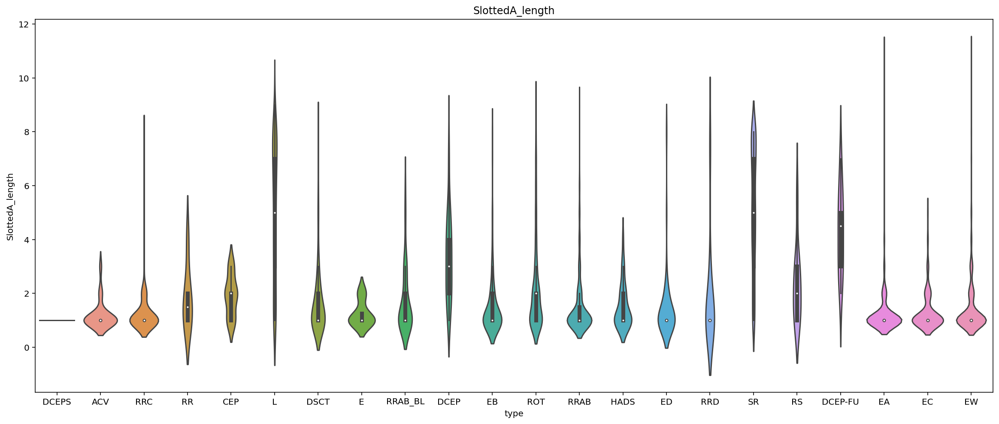

SmallKurtosis


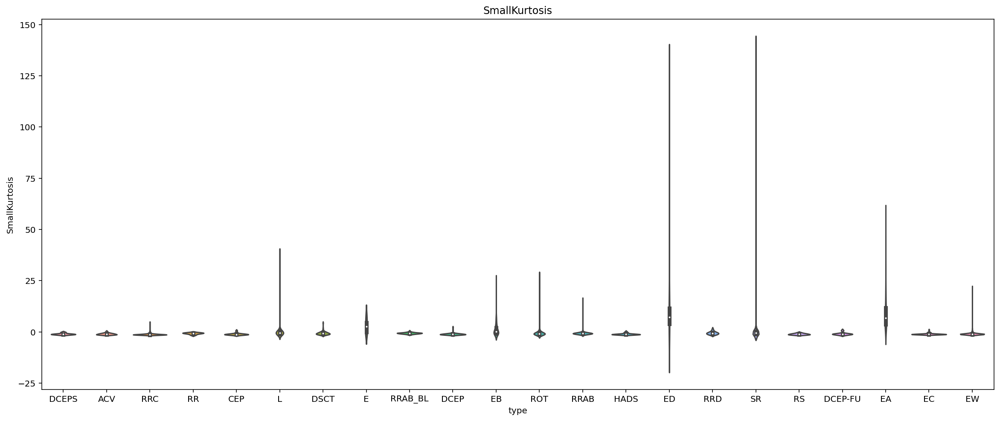

Std


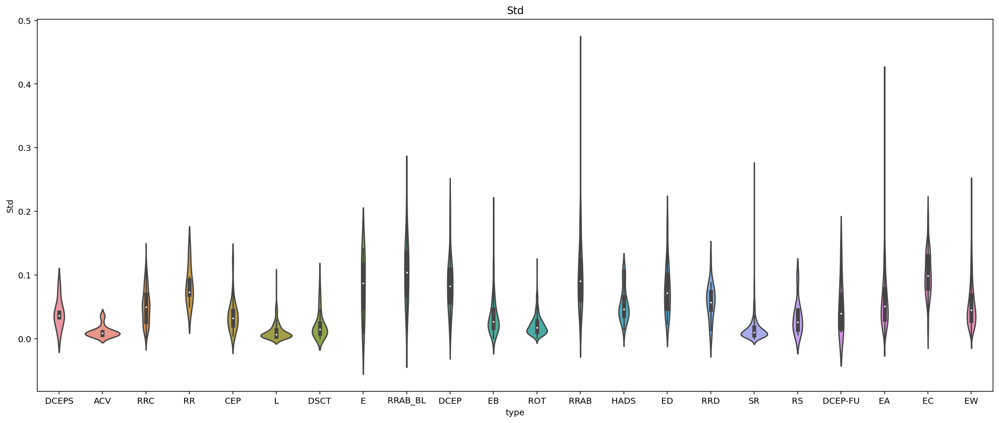

StructureFunction_index_21


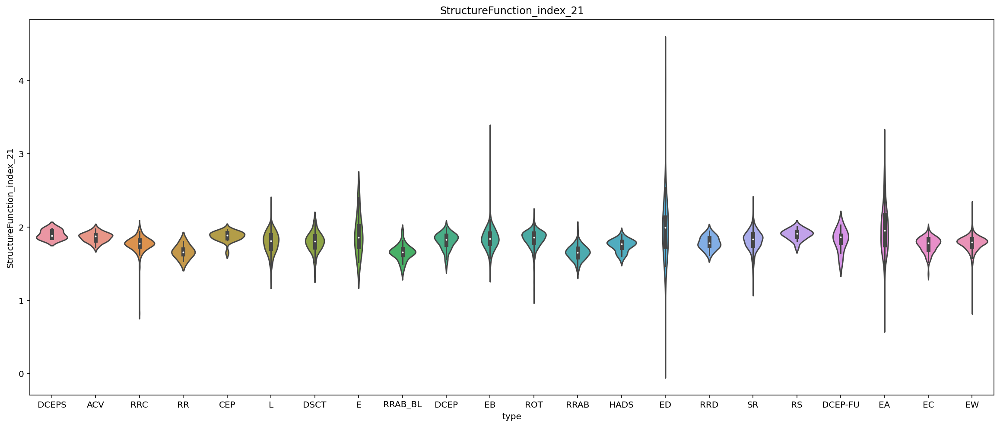

StructureFunction_index_31


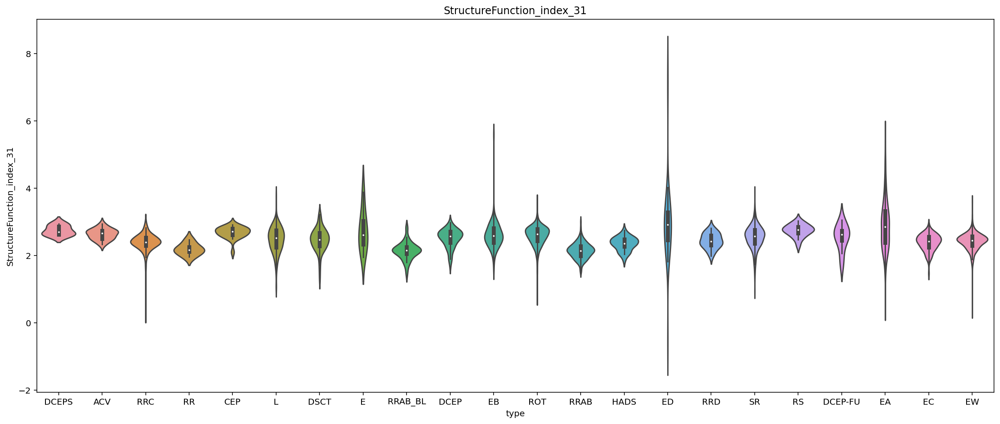

StructureFunction_index_32


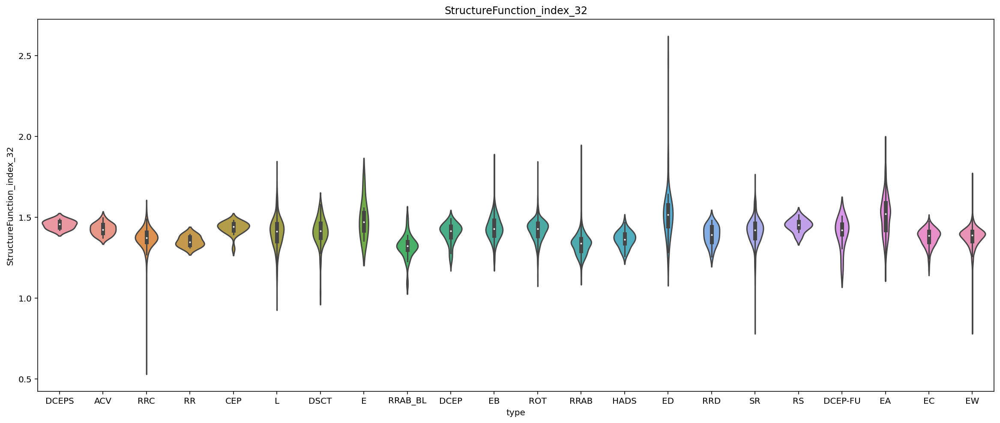

In [92]:
features = ['Amplitude', 'Autocor_length', 'Beyond1Std', 'CAR_mean',
       'CAR_sigma',
       'CAR_tau',
       'Con',
       'Eta_e', 'FluxPercentileRatioMid20',
       'FluxPercentileRatioMid35', 'FluxPercentileRatioMid50',
       'FluxPercentileRatioMid65', 'FluxPercentileRatioMid80',
       'Freq1_harmonics_amplitude_0', 'Freq1_harmonics_amplitude_1',
       'Freq1_harmonics_amplitude_2', 'Freq1_harmonics_amplitude_3',
       'Freq1_harmonics_rel_phase_0', 'Freq1_harmonics_rel_phase_1',
       'Freq1_harmonics_rel_phase_2', 'Freq1_harmonics_rel_phase_3',
       'Freq2_harmonics_amplitude_0', 'Freq2_harmonics_amplitude_1',
       'Freq2_harmonics_amplitude_2', 'Freq2_harmonics_amplitude_3',
       'Freq2_harmonics_rel_phase_0', 'Freq2_harmonics_rel_phase_1',
       'Freq2_harmonics_rel_phase_2', 'Freq2_harmonics_rel_phase_3',
       'Freq3_harmonics_amplitude_0', 'Freq3_harmonics_amplitude_1',
       'Freq3_harmonics_amplitude_2', 'Freq3_harmonics_amplitude_3',
       'Freq3_harmonics_rel_phase_0', 'Freq3_harmonics_rel_phase_1',
       'Freq3_harmonics_rel_phase_2', 'Freq3_harmonics_rel_phase_3', 'Gskew',
       'LinearTrend', 'MaxSlope', 'Mean', 'Meanvariance', 'MedianAbsDev',
       'MedianBRP', 'PairSlopeTrend', 'PercentAmplitude',
       'PercentDifferenceFluxPercentile', 'PeriodLS',
       # 'Period_fit',
       'Psi_CS',
       'Psi_eta', 'Q31', 'Rcs', 'Skew', 'SlottedA_length', 'SmallKurtosis',
       'Std', 'StructureFunction_index_21', 'StructureFunction_index_31',
       'StructureFunction_index_32']


for feature in features:
    print(feature)
    plt.figure(figsize=(20, 8))
    sns.violinplot(x="type", y=df[feature], data=df)
    plt.title(f"{feature}")
    plt.show()

In [93]:
import corner
import numpy as np
import pandas as pd

In [94]:
df = pd.read_csv("outputs/nb3/features_.csv")

In [97]:
df.columns

Index(['Unnamed: 0', 'Amplitude', 'Autocor_length', 'Beyond1Std', 'CAR_mean',
       'CAR_sigma', 'CAR_tau', 'Con', 'Eta_e', 'FluxPercentileRatioMid20',
       'FluxPercentileRatioMid35', 'FluxPercentileRatioMid50',
       'FluxPercentileRatioMid65', 'FluxPercentileRatioMid80',
       'Freq1_harmonics_amplitude_0', 'Freq1_harmonics_amplitude_1',
       'Freq1_harmonics_amplitude_2', 'Freq1_harmonics_amplitude_3',
       'Freq1_harmonics_rel_phase_0', 'Freq1_harmonics_rel_phase_1',
       'Freq1_harmonics_rel_phase_2', 'Freq1_harmonics_rel_phase_3',
       'Freq2_harmonics_amplitude_0', 'Freq2_harmonics_amplitude_1',
       'Freq2_harmonics_amplitude_2', 'Freq2_harmonics_amplitude_3',
       'Freq2_harmonics_rel_phase_0', 'Freq2_harmonics_rel_phase_1',
       'Freq2_harmonics_rel_phase_2', 'Freq2_harmonics_rel_phase_3',
       'Freq3_harmonics_amplitude_0', 'Freq3_harmonics_amplitude_1',
       'Freq3_harmonics_amplitude_2', 'Freq3_harmonics_amplitude_3',
       'Freq3_harmonics_rel_pha

DCEPS


ACV


RRC


RR


CEP


L


DSCT


E


RRAB_BL


DCEP


EB


ROT
RRAB


HADS


ED


RRD


SR


RS


DCEP-FU


EA


/home/jorge/anaconda3/envs/py310/lib/python3.10/site-packages/corner/corner.py:271: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axes = pl.subplots(K, K, figsize=(dim, dim))


EC
EW


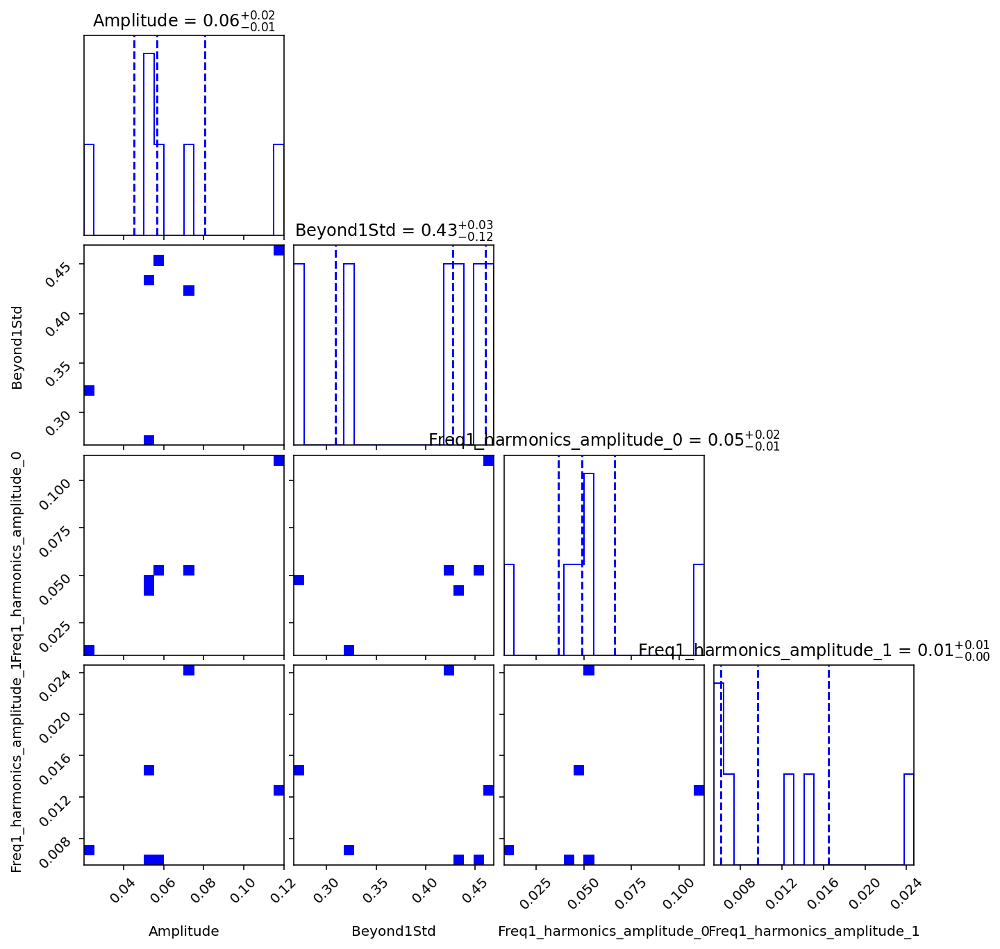

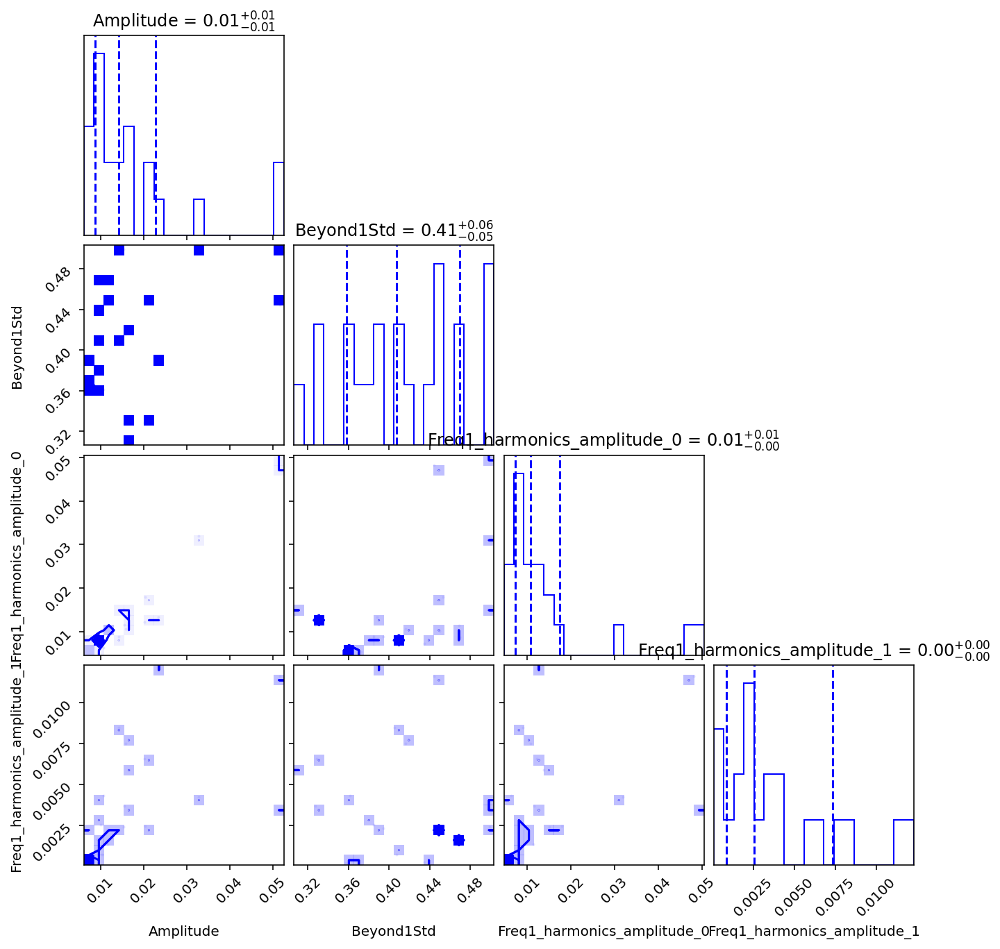

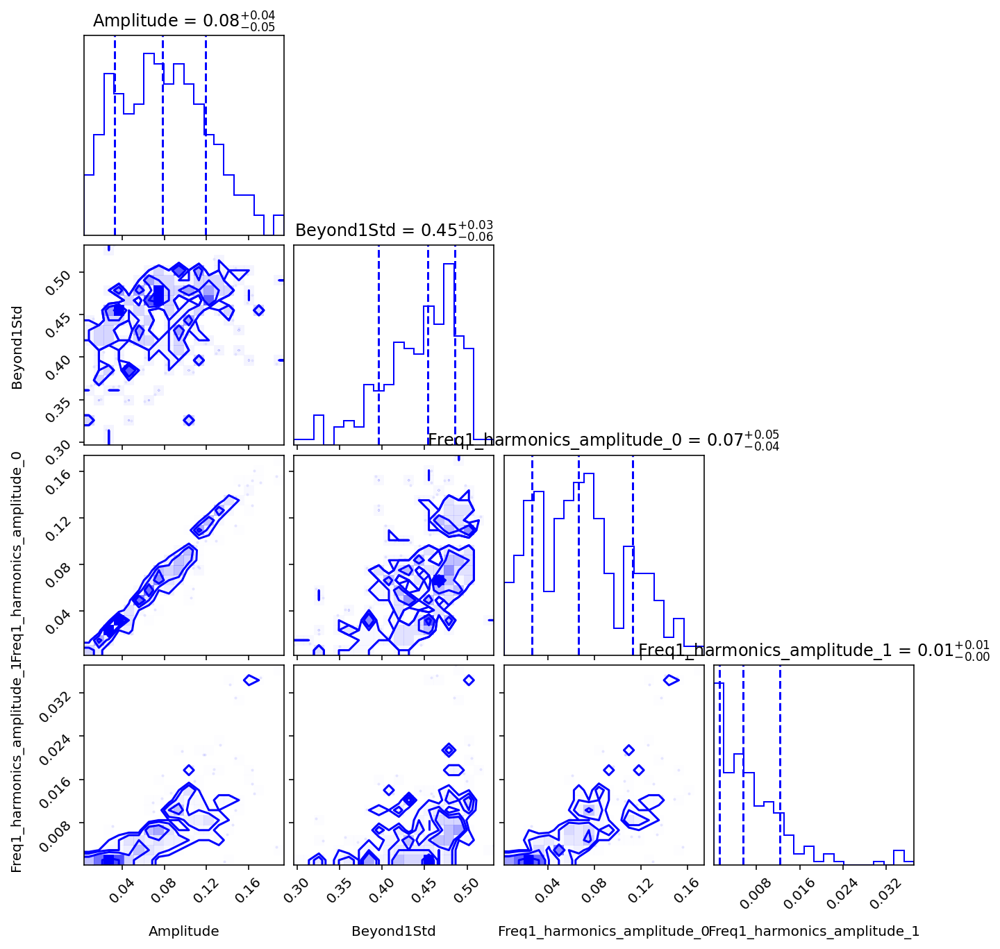

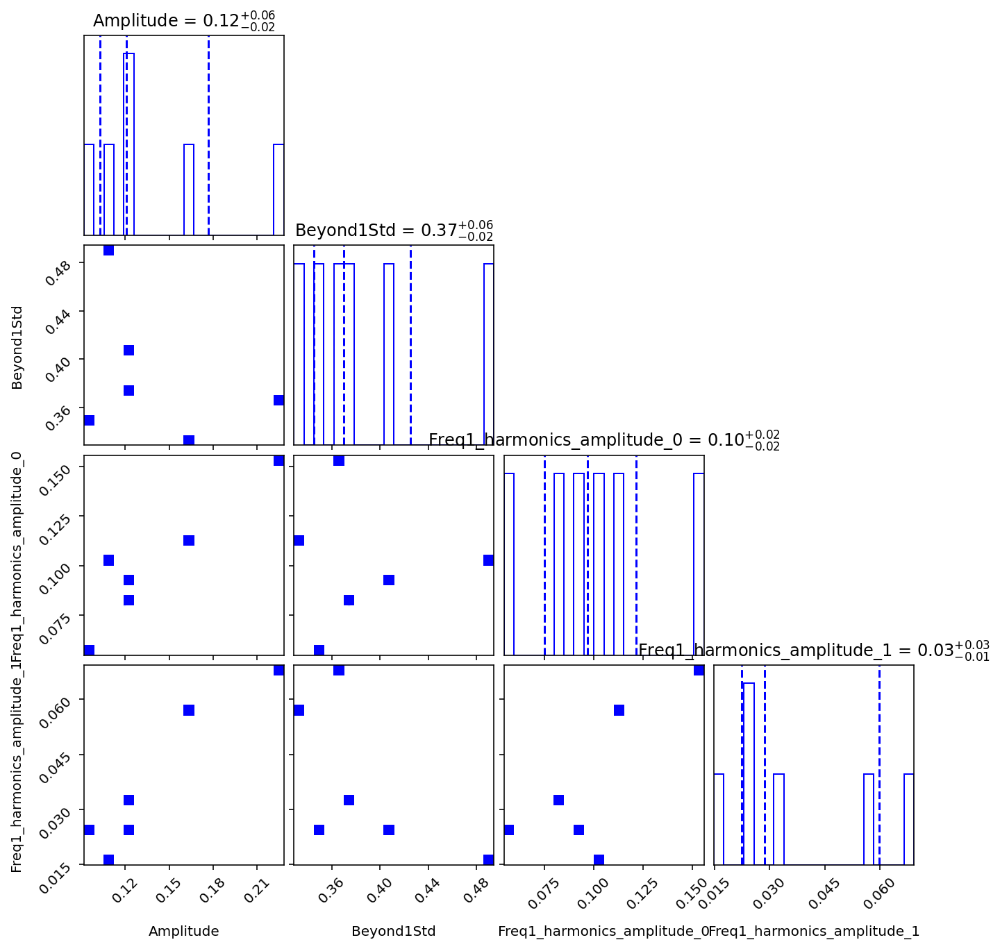

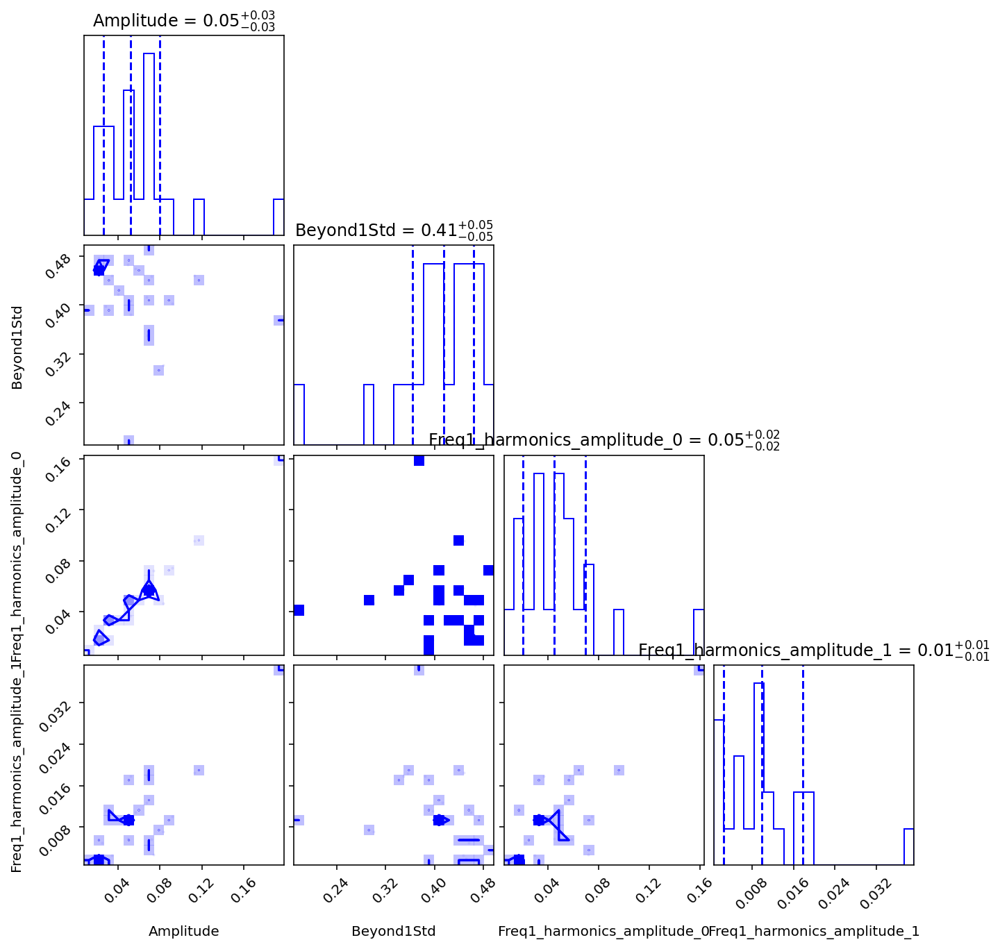

...

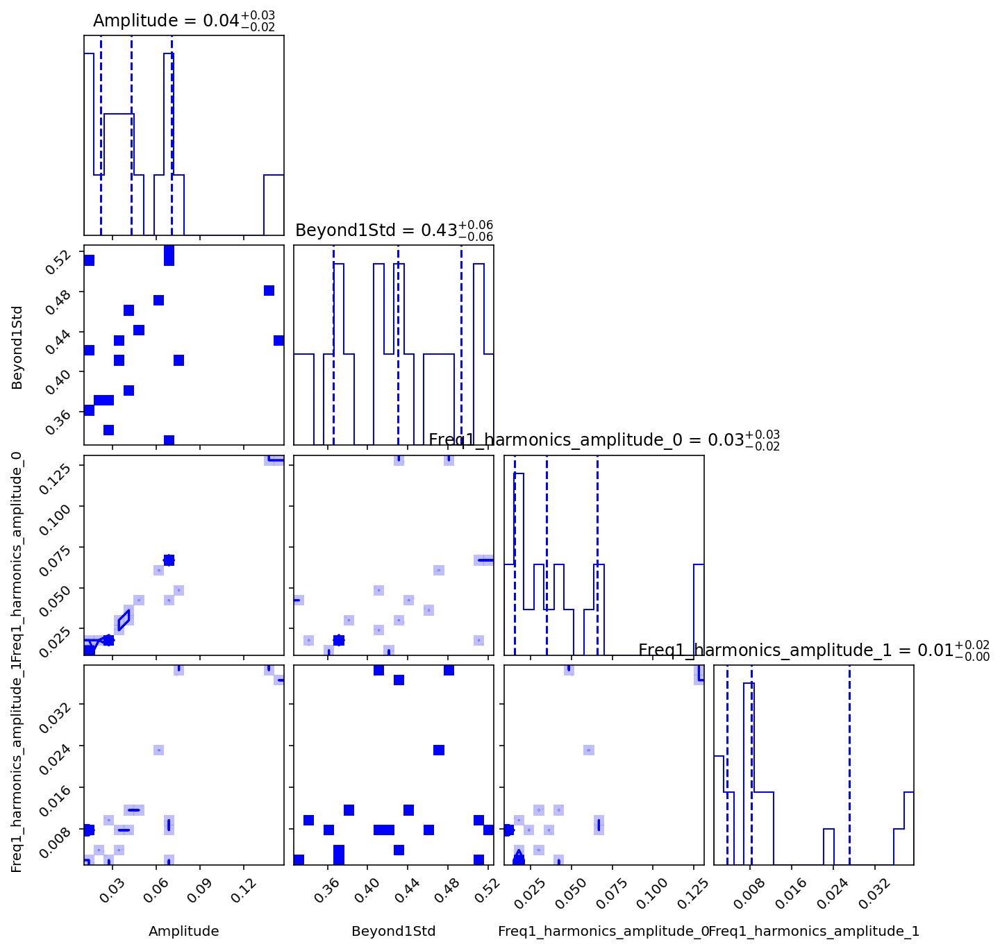

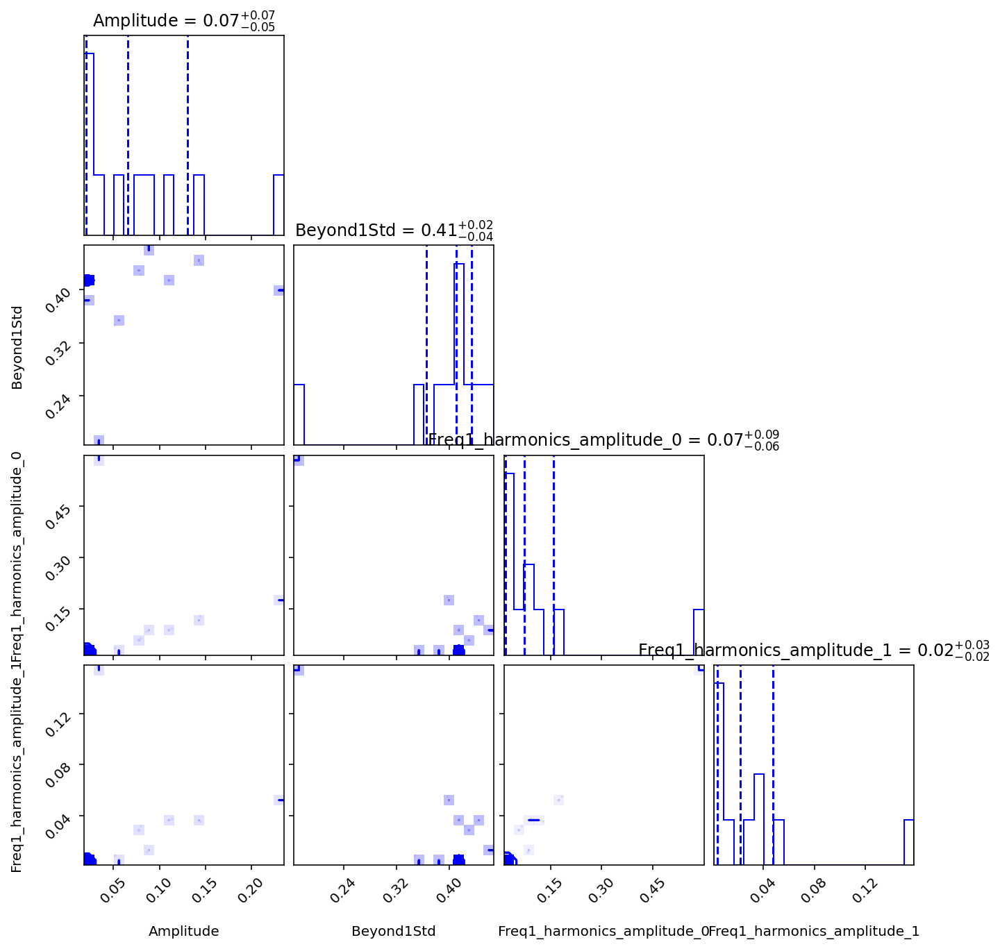

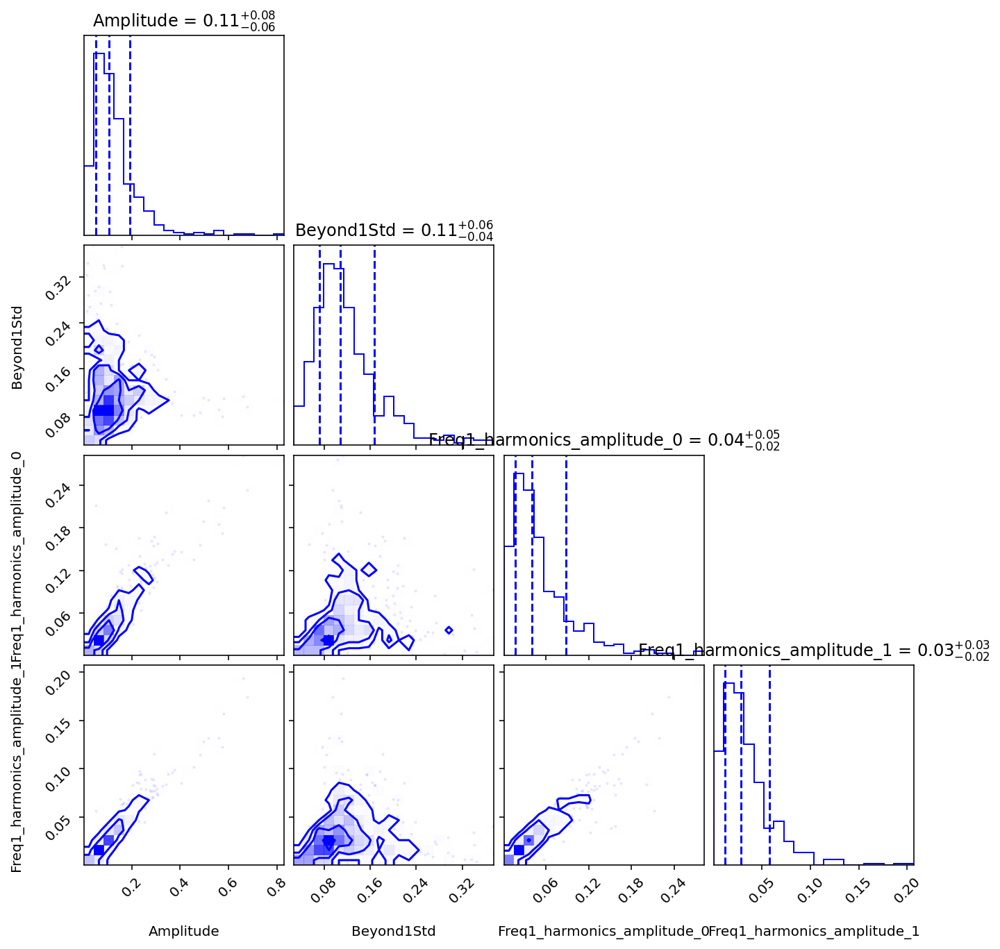

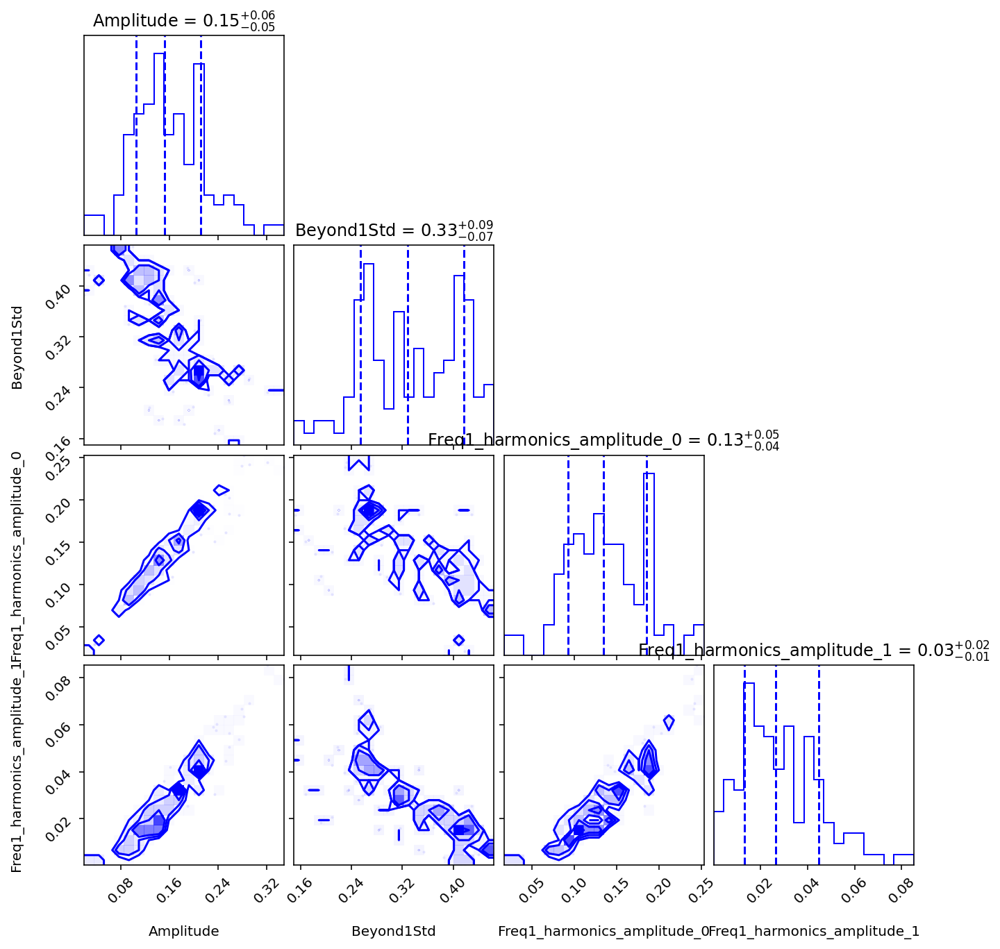

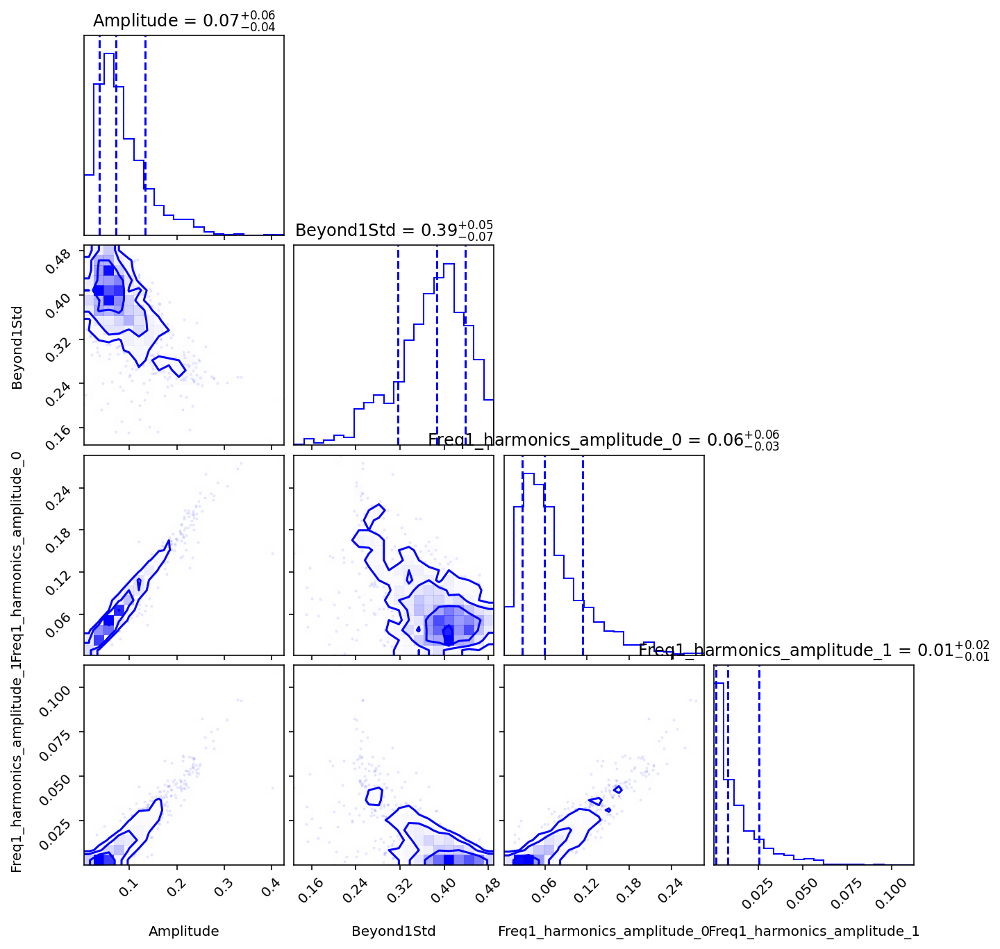

In [98]:
cols = ["Amplitude", "Beyond1Std", "Freq1_harmonics_amplitude_0", "Freq1_harmonics_amplitude_1"]
for vtype in df.type.unique():
    print(vtype)
    df_type = df.query("type==@vtype")
    corner.corner(df_type[cols].values, labels=cols, quantiles=[0.16, 0.5, 0.84], show_titles=True, title_kwargs={"fontsize": 12}, color="blue")

# Multiple corner plots

In [109]:
from matplotlib.pyplot import cm
n = len(df.type.unique())
colors = iter(cm.rainbow(np.linspace(0, 1, n)))

DCEPS [0.5 0.  1.  1. ]


ACV [0.40588235 0.1473017  0.99726917 1.        ]
RRC [0.31176471 0.29138975 0.98909161 1.        ]
RR [0.21764706 0.42912061 0.97551197 1.        ]


CEP [0.12352941 0.55748944 0.95660442 1.        ]
L [0.02941176 0.67369564 0.93247223 1.        ]
DSCT [0.07254902 0.78292761 0.9005867  1.        ]
E [0.16666667 0.8660254  0.8660254  1.        ]


RRAB_BL [0.26078431 0.93022931 0.82673417 1.        ]
DCEP [0.35490196 0.9741386  0.78292761 1.        ]
EB [0.44901961 0.99679532 0.73484497 1.        ]
ROT [0.55098039 0.99679532 0.67823512 1.        ]


RRAB [0.64509804 0.9741386  0.62211282 1.        ]
HADS [0.73921569 0.93022931 0.56259275 1.        ]
ED [0.83333333 0.8660254  0.5        1.        ]


RRD [0.92745098 0.78292761 0.43467642 1.        ]
SR [1.         0.67369564 0.36124167 1.        ]
RS [1.         0.55748944 0.29138975 1.        ]


DCEP-FU [1.         0.42912061 0.21994636 1.        ]
EA [1.         0.29138975 0.1473017  1.        ]
EC [1.         0.1473017  0.07385253 1.        ]
EW [1.0000000e+00 1.2246468e-16 6.1232340e-17 1.0000000e+00]


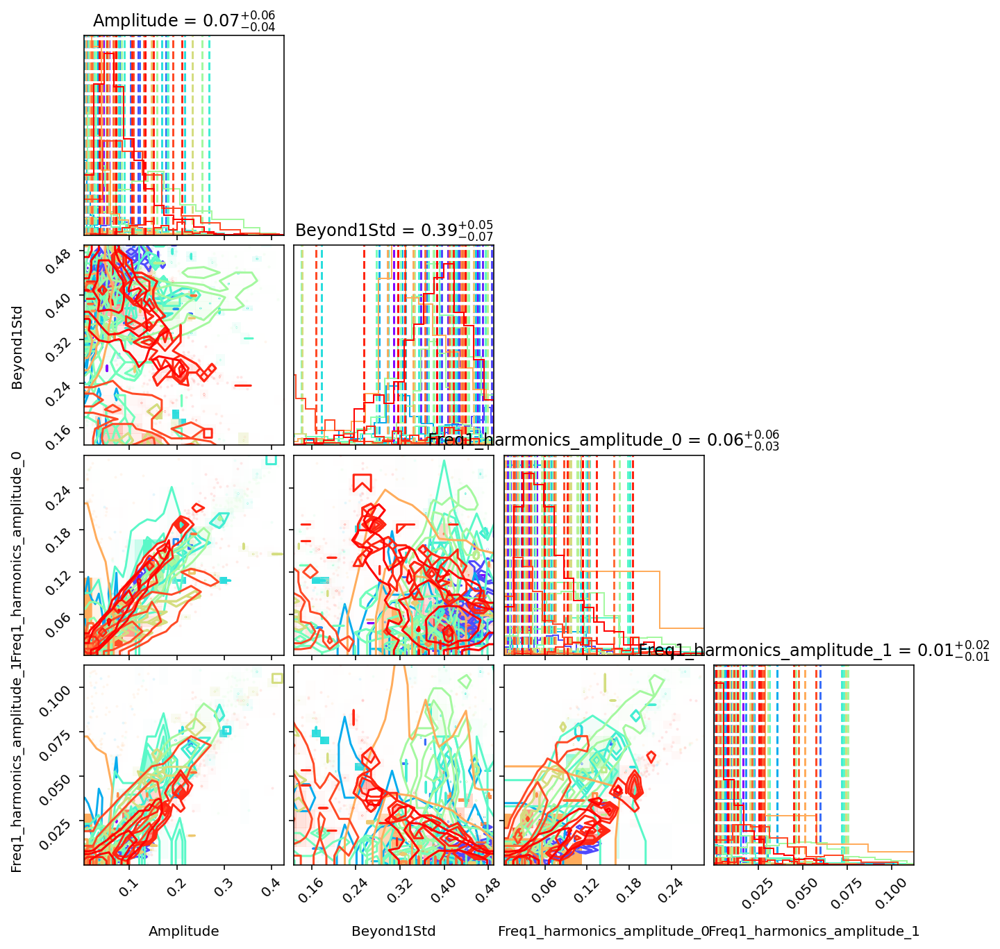

In [112]:
# Multiple plots
cols = ["Amplitude", "Beyond1Std", "Freq1_harmonics_amplitude_0", "Freq1_harmonics_amplitude_1"]
fig=None
for vtype, color in zip(df.type.unique(), colors):
    print(vtype, color)
    df_type = df.query("type==@vtype")
    fig = corner.corner(df_type[cols].values, labels=cols, quantiles=[0.16, 0.5, 0.84], show_titles=True, title_kwargs={"fontsize": 12}, color=color, fig=fig)

## Summary <a class="anchor" id="fifth-bullet"></a>

At this point, all of you should have:
* an understanding of time series in astronomy
* seen some algorithms for extracting information from time series
* applied this to TESS light-curve data.

In [ ]:
# calculating Anderson-Darling
anderson = scipy.stats.anderson(data['mag'])
## here you have to get the values first out of that data structure 
anderson_darling_value = anderson[0] 

# then for Stetson: calculate only the StetsonK 